usando redes neurais convolucionais para criar um detector de emoções em fotos e em videos

#Importações das bibliotecas e montagem do drive

In [1]:
#importando bibliotecas
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
from google.colab.patches import cv2_imshow
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPooling2D

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
caminho = '/content/drive/MyDrive/estudo de visao computacional/Datasets/fer_images.zip'
zipado = zipfile.ZipFile(caminho, mode='r')
zipado.extractall('./')
zipado.close

<bound method ZipFile.close of <zipfile.ZipFile filename='/content/drive/MyDrive/estudo de visao computacional/Datasets/fer_images.zip' mode='r'>>

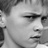

In [ ]:
tf.keras.preprocessing.image.load_img('/content/fer2013/train/Angry/102.jpg')

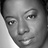

In [ ]:
tf.keras.preprocessing.image.load_img('/content/fer2013/train/Neutral/1020.jpg')

In [ ]:
gerador_treino = ImageDataGenerator(rescale=1./255,
                                    rotation_range=7,
                                    horizontal_flip=True,
                                    zoom_range=0.2)
base_treino = gerador_treino.flow_from_directory('/content/fer2013/train',
                                                 target_size=(48,48),
                                                 batch_size=16,
                                                 class_mode='categorical',
                                                 shuffle=True)

Found 28709 images belonging to 7 classes.


In [ ]:
np.unique(base_treino.classes, return_counts=True)

(array([0, 1, 2, 3, 4, 5, 6], dtype=int32),
 array([3995,  436, 4097, 7215, 4965, 4830, 3171]))

In [ ]:
gerador_teste = ImageDataGenerator(rescale=1./255)
base_teste = gerador_teste.flow_from_directory('/content/fer2013/validation',
                                               target_size=(48,48),
                                               class_mode='categorical',
                                               shuffle=False)

Found 3589 images belonging to 7 classes.


In [ ]:
np.unique(base_teste.classes, return_counts=True)

(array([0, 1, 2, 3, 4, 5, 6], dtype=int32),
 array([491,  55, 528, 879, 626, 594, 416]))

In [ ]:
base_treino.class_indices

{'Angry': 0,
 'Disgust': 1,
 'Fear': 2,
 'Happy': 3,
 'Neutral': 4,
 'Sad': 5,
 'Surprise': 6}

<Axes: ylabel='count'>

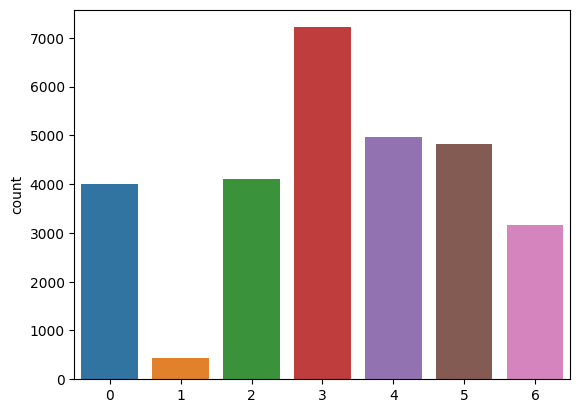

In [ ]:
sns.countplot(x=base_treino.classes)

In [ ]:
# Based on: https://github.com/rajeevratan84/DeepLearningCV/blob/master/18.2%20Building%20an%20Emotion%20Detector%20with%20LittleVGG.ipynb
#padding: o tipo 'VALID' ignora os pixeis das bordas na hora da aplicação de kernel, já o 'SAME', mantem todos os pixeis, mantendo o tamanho da imagem
numero_detectores = 32
#numero de filtros da rede neural
numero_classes = 7
largura, altura = 48, 48
epocas = 150

rede = Sequential()
rede.add(Conv2D(filters = numero_detectores, kernel_size=(3,3), activation='relu', padding='same', input_shape=(largura,altura,3)))
rede.add(BatchNormalization())
rede.add(Conv2D(filters = numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(MaxPooling2D(pool_size=(2,2)))
rede.add(Dropout(0.2))

rede.add(Conv2D(filters = 2*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(Conv2D(filters = 2*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(MaxPooling2D(pool_size=(2,2)))
rede.add(Dropout(0.2))

rede.add(Conv2D(filters = 4*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(Conv2D(filters = 4*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(MaxPooling2D(pool_size=(2,2)))
rede.add(Dropout(0.2))

rede.add(Conv2D(filters = 8*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(Conv2D(filters = 8*numero_detectores, kernel_size=(3,3), activation='relu', padding='same'))
rede.add(BatchNormalization())
rede.add(MaxPooling2D(pool_size=(2,2)))
rede.add(Dropout(0.2))

rede.add(Flatten())

rede.add(Dense(units= 2*numero_detectores, activation='relu'))
rede.add(BatchNormalization())
rede.add(Dropout(0.2))

rede.add(Dense(units= 2*numero_detectores, activation='relu'))
rede.add(BatchNormalization())
rede.add(Dropout(0.2))

rede.add(Dense(units=numero_classes, activation='softmax'))

In [ ]:
rede.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 32)        896       
                                                                 
 batch_normalization (BatchN  (None, 48, 48, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 32)       0         
 )                                                               
                                                        

In [ ]:
len(rede.layers)

32

In [ ]:
rede.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
historico = rede.fit(base_treino, epochs=epocas)

Epoch 1/150
1795/1795 [==============================] - 73s 31ms/step - loss: 1.8553 - accuracy: 0.2635
Epoch 2/150
1795/1795 [==============================] - 55s 31ms/step - loss: 1.5546 - accuracy: 0.3914
Epoch 3/150
1795/1795 [==============================] - 51s 29ms/step - loss: 1.3967 - accuracy: 0.4638
Epoch 4/150
1795/1795 [==============================] - 54s 30ms/step - loss: 1.3197 - accuracy: 0.5001
Epoch 5/150
1795/1795 [==============================] - 53s 29ms/step - loss: 1.2691 - accuracy: 0.5200
Epoch 6/150
1795/1795 [==============================] - 53s 29ms/step - loss: 1.2258 - accuracy: 0.5449
Epoch 7/150
1795/1795 [==============================] - 51s 28ms/step - loss: 1.1889 - accuracy: 0.5554
Epoch 8/150
1795/1795 [==============================] - 54s 30ms/step - loss: 1.1737 - accuracy: 0.5627
Epoch 9/150
1795/1795 [==============================] - 53s 29ms/step - loss: 1.1436 - accuracy: 0.5729
Epoch 10/150
1795/1795 [==============================]

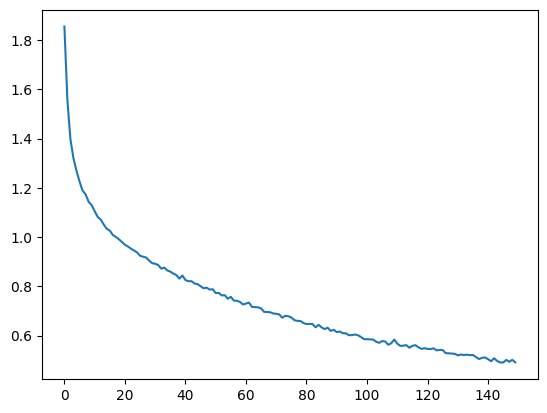

In [ ]:
plt.plot(historico.history['loss'])

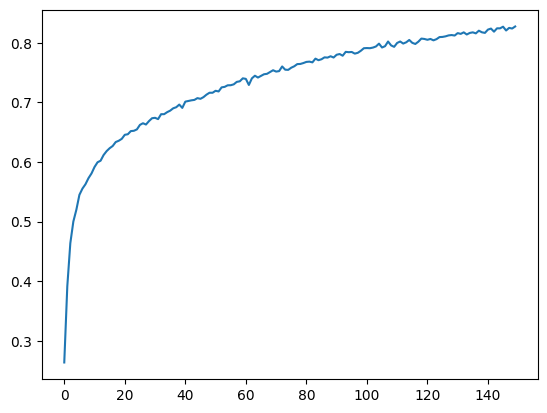

In [ ]:
plt.plot(historico.history['accuracy'])

In [ ]:
arquitetura = rede.to_json()
with open('/content/drive/MyDrive/redes neurais/arquitetura_emocoes.json', 'w') as arquivo:
  arquivo.write(arquitetura)

In [ ]:
from keras.models import save_model
rede_salva = save_model(rede,'/content/drive/MyDrive/redes neurais/pesos_emocoes.hdf5')

In [3]:
with open('/content/drive/MyDrive/redes neurais/arquitetura_emocoes.json', 'r') as arquivo:
  arquitetura = arquivo.read()

In [4]:
rede = tf.keras.models.model_from_json(arquitetura)
rede.load_weights('/content/drive/MyDrive/redes neurais/pesos_emocoes.hdf5')
rede.compile(optimizer='Adam', loss='categorical_crossentropy', metrics = ['accuracy'])

In [ ]:
rede.evaluate(base_teste)

113/113 [==============================] - 10s 21ms/step - loss: 1.8228 - accuracy: 0.5960


[1.822757363319397, 0.5959877371788025]

In [ ]:
previsoes = rede.predict(base_teste)
previsoes = np.argmax(previsoes, axis=1)
previsoes

113/113 [==============================] - 2s 17ms/step


array([0, 0, 0, ..., 6, 6, 6])

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(base_teste.classes, previsoes)

0.5959877403176372

<Axes: >

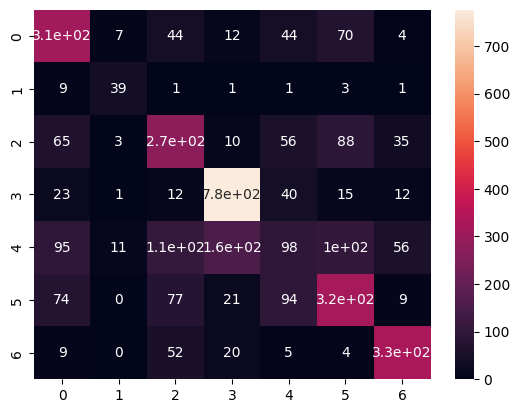

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(base_teste.classes, previsoes)
sns.heatmap(cm, annot=True)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(base_teste.classes, previsoes))

              precision    recall  f1-score   support

           0       0.53      0.63      0.58       491
           1       0.64      0.71      0.67        55
           2       0.48      0.51      0.50       528
           3       0.78      0.88      0.83       879
           4       0.29      0.16      0.20       626
           5       0.53      0.54      0.53       594
           6       0.74      0.78      0.76       416

    accuracy                           0.60      3589
   macro avg       0.57      0.60      0.58      3589
weighted avg       0.57      0.60      0.58      3589



## aqui vamos pegar uma imagem e selecionar apenas a face(usando haarcascade)(posteriormente trocar para HOG) dela para fazer a previsão com a rede

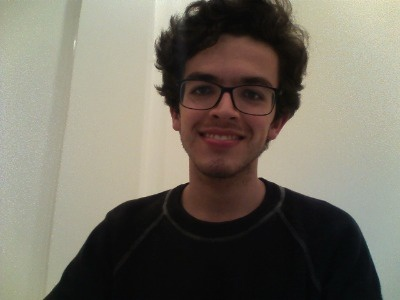

In [ ]:
imagem = cv2.imread('/content/drive/MyDrive/estudo de visao computacional/Images/gabriel.png')
cv2_imshow(imagem)

In [ ]:
imagem.shape

(300, 400, 3)

In [8]:
detector = cv2.CascadeClassifier('/content/drive/MyDrive/estudo de visao computacional/Cascades/haarcascade_frontalface_default.xml')

In [ ]:
imagem_original = imagem.copy()
deteccoes = detector.detectMultiScale(imagem_original)

In [ ]:
deteccoes

array([[162,  40, 128, 128]], dtype=int32)

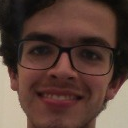

In [ ]:
#roi = regiao de interesse
roi = imagem[40:40+128, 162:162+128]
cv2_imshow(roi)

In [ ]:
roi.shape

(128, 128, 3)

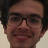

In [ ]:
roi = cv2.resize(roi, (48,48))
cv2_imshow(roi)

In [ ]:
roi.shape

(48, 48, 3)

In [ ]:
roi = np.expand_dims(roi, axis=0)
roi.shape

(1, 48, 48, 3)

In [ ]:
base_treino.class_indices

In [ ]:
roi = roi/255

In [ ]:
probabilidades = rede.predict(roi)
probabilidades = np.argmax(probabilidades, axis=1)
probabilidades

1/1 [==============================] - 0s 204ms/step


array([3])

deu que ele estava feliz

## classificando várias imagens

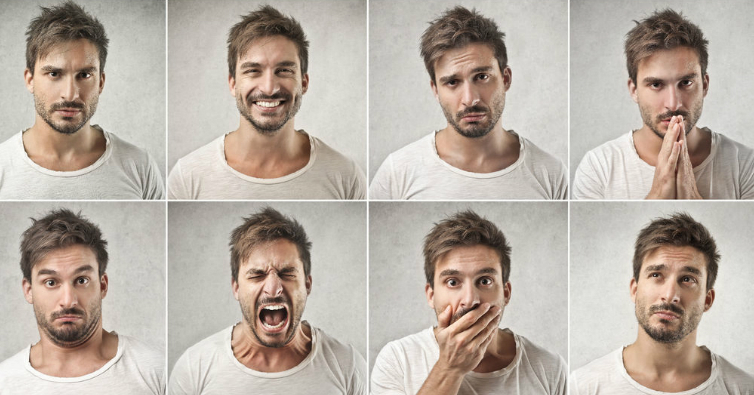

In [ ]:
imagem = cv2.imread('/content/drive/MyDrive/estudo de visao computacional/Images/faces_emotions.png')
cv2_imshow(imagem)

In [ ]:
deteccoes = detector.detectMultiScale(imagem)
deteccoes

array([[625,  49,  91,  91],
       [224,  35,  90,  90],
       [ 23,  41,  92,  92],
       [420,  43,  97,  97],
       [420, 242,  97,  97],
       [ 18, 243,  98,  98],
       [229, 242,  85,  85],
       [627, 241,  91,  91]], dtype=int32)

In [ ]:
base_treino.class_indices.keys()

dict_keys(['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprise'])

In [11]:
emotions = ['Raiva', 'Desgosto', 'Medo', 'Feliz', 'Neutro', 'Triste', 'Surpresa']

1/1 [==============================] - 0s 23ms/step


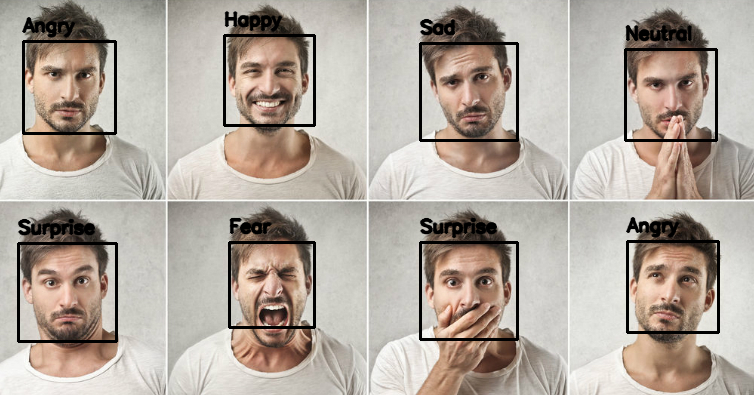

In [ ]:
for (x,y,w,h) in deteccoes:
  cv2.rectangle(imagem, (x,y), (x+w,y+h), (0,0,0), 2)
  roi = imagem[y:y+h, x:x+w]
  roi = cv2.resize(roi, (48,48))
  roi = roi/255
  roi = np.expand_dims(roi, axis=0)
  previsao = rede.predict(roi)
  cv2.putText(imagem, emotions[np.argmax(previsao)], (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,0), 2, cv2.LINE_AA)
cv2_imshow(imagem)

detecção de emoções em videos

In [5]:
cap = cv2.VideoCapture('/content/drive/MyDrive/estudo de visao computacional/Videos/emotion_test01.mp4')
conectado, video = cap.read()
print(conectado, video.shape)

True (360, 640, 3)


In [6]:
#fourcc é um codec para salvar videos para saber mais: fourcc.org
caminho_salvo = '/content/drive/MyDrive/estudo de visao computacional/Videos/emotion_test01_resultado.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
fps = 24
output_video = cv2.VideoWriter(caminho_salvo, fourcc, fps, (video.shape[1], video.shape[0]))
#essa variavel grava o vídeo após o processamento

1/1 [==============================] - 0s 21ms/step


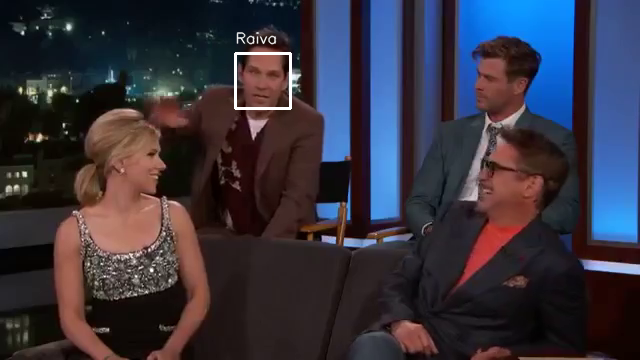

1/1 [==============================] - 0s 23ms/step


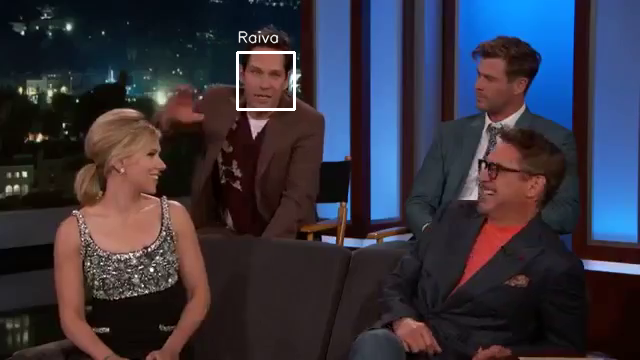

1/1 [==============================] - 0s 19ms/step


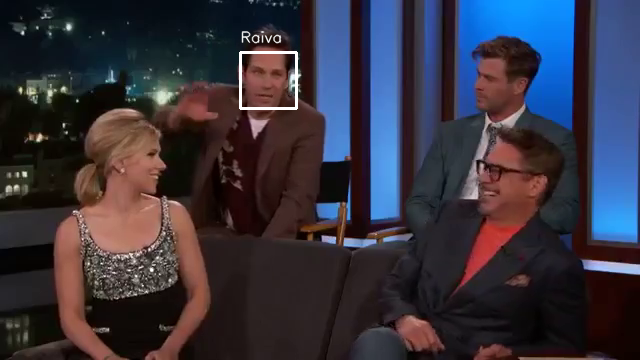

1/1 [==============================] - 0s 35ms/step


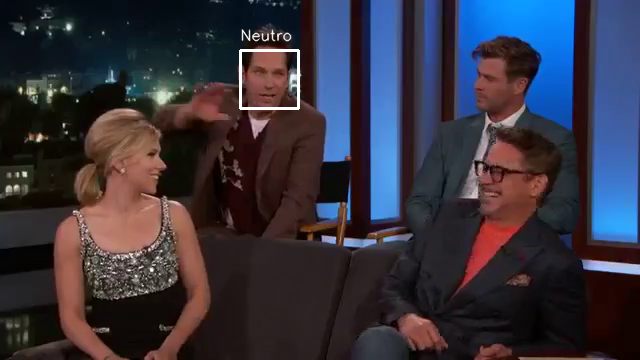

1/1 [==============================] - 0s 64ms/step


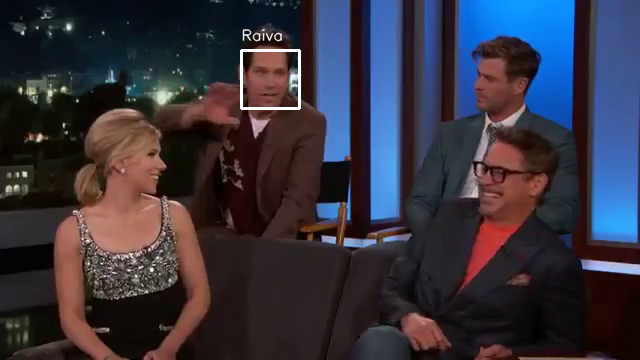

1/1 [==============================] - 0s 84ms/step


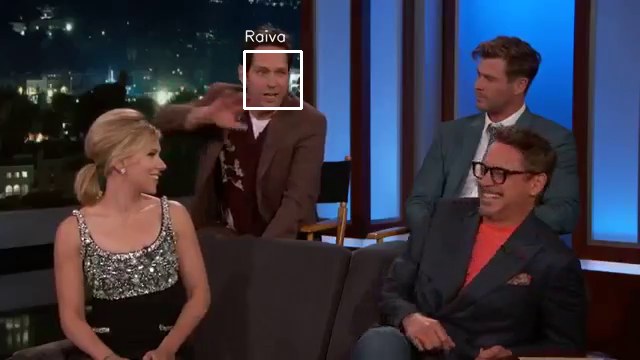

1/1 [==============================] - 0s 44ms/step


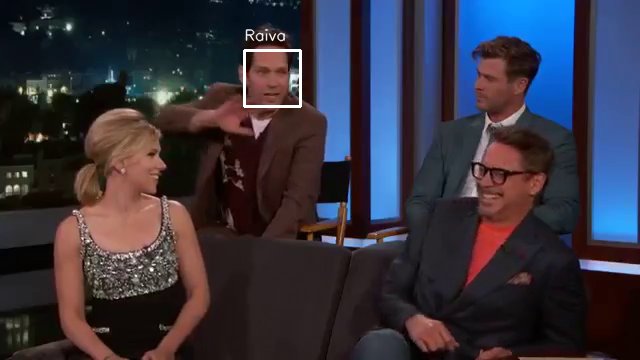

1/1 [==============================] - 0s 49ms/step


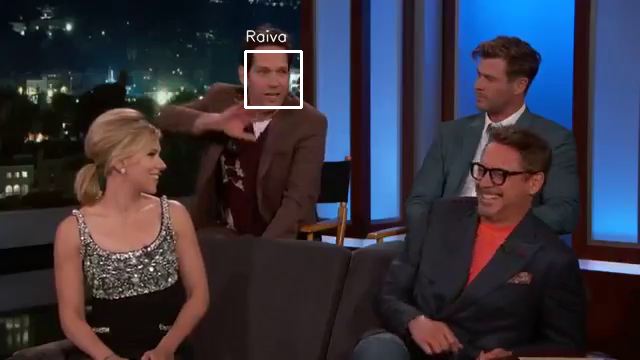

1/1 [==============================] - 0s 56ms/step


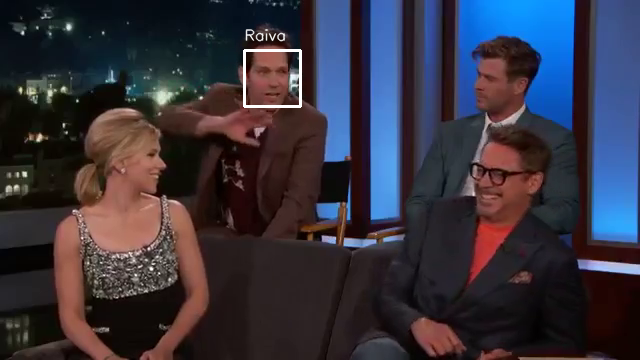

1/1 [==============================] - 0s 29ms/step


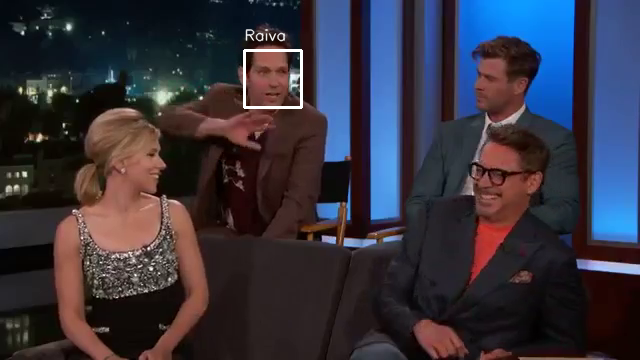

1/1 [==============================] - 0s 77ms/step


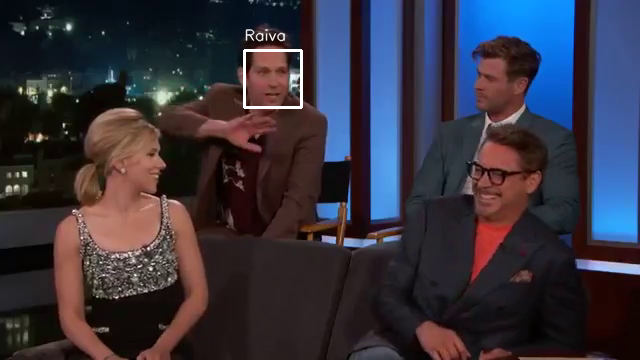

1/1 [==============================] - 0s 34ms/step


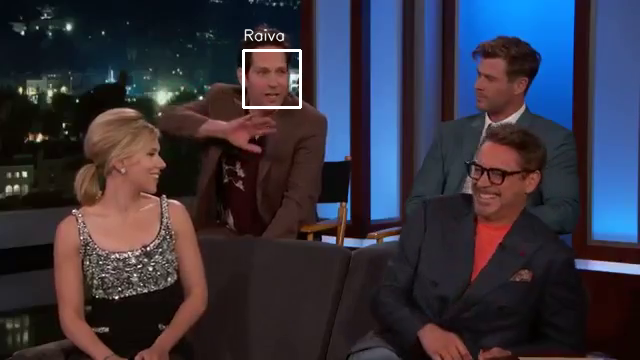

1/1 [==============================] - 0s 47ms/step


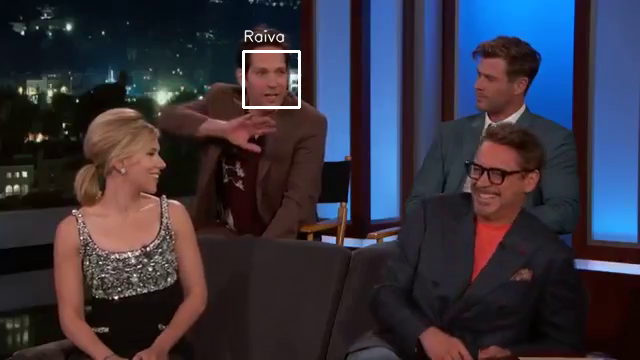

1/1 [==============================] - 0s 42ms/step


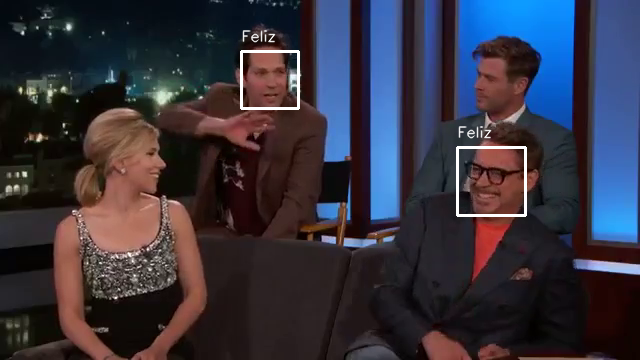

1/1 [==============================] - 0s 51ms/step


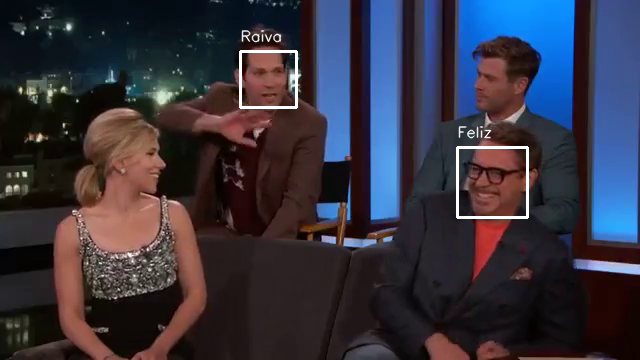

1/1 [==============================] - 0s 59ms/step


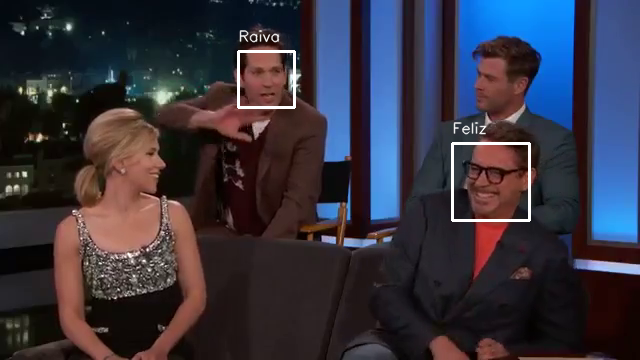

1/1 [==============================] - 0s 51ms/step


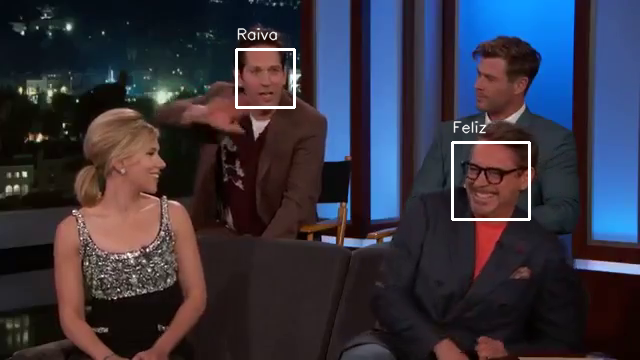

1/1 [==============================] - 0s 48ms/step


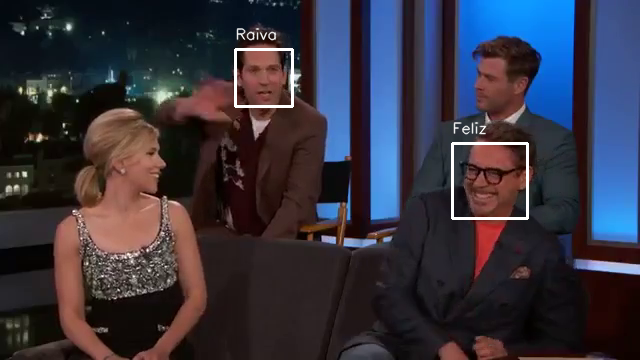

1/1 [==============================] - 0s 54ms/step


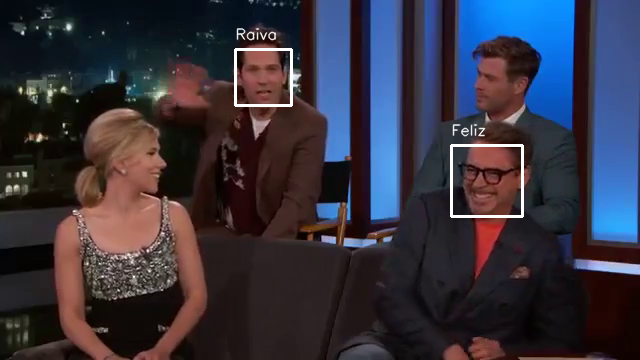

1/1 [==============================] - 0s 41ms/step


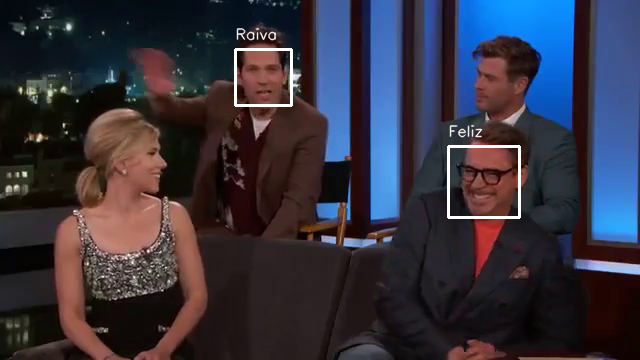

1/1 [==============================] - 0s 32ms/step


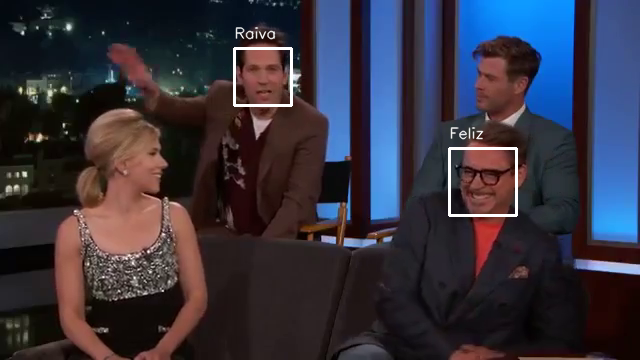

1/1 [==============================] - 0s 45ms/step


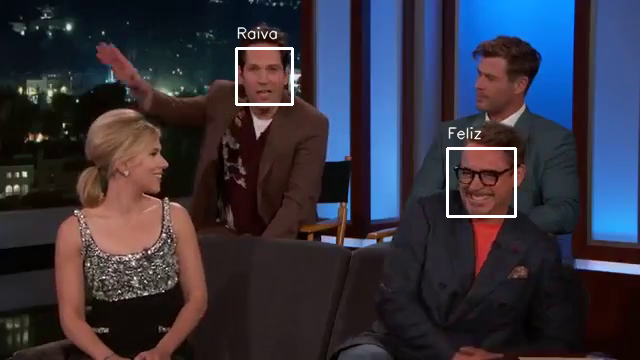

1/1 [==============================] - 0s 33ms/step


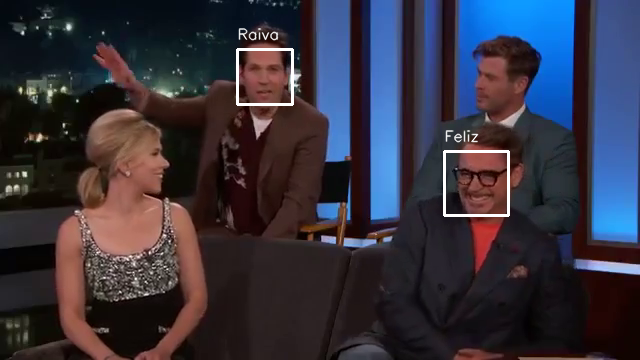

1/1 [==============================] - 0s 43ms/step


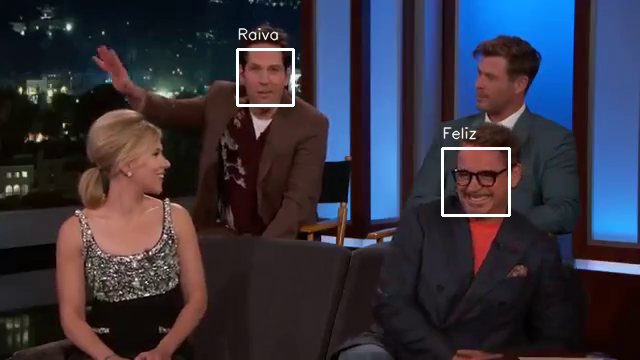

1/1 [==============================] - 0s 37ms/step


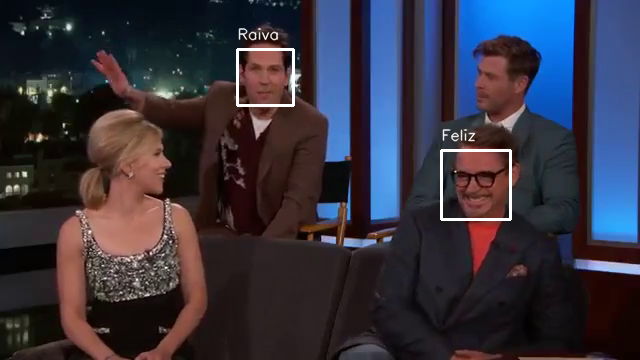

1/1 [==============================] - 0s 45ms/step


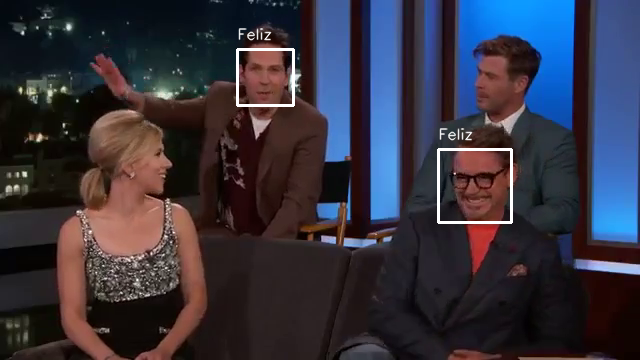

1/1 [==============================] - 0s 28ms/step


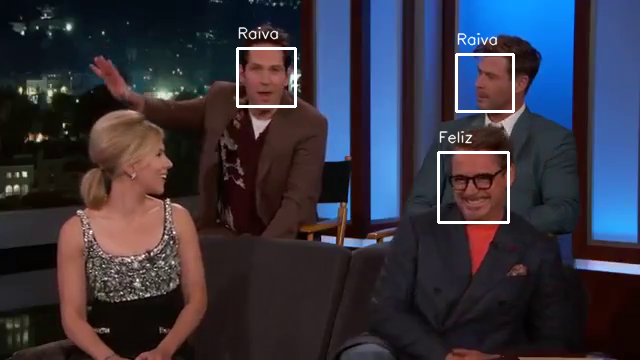

1/1 [==============================] - 0s 65ms/step


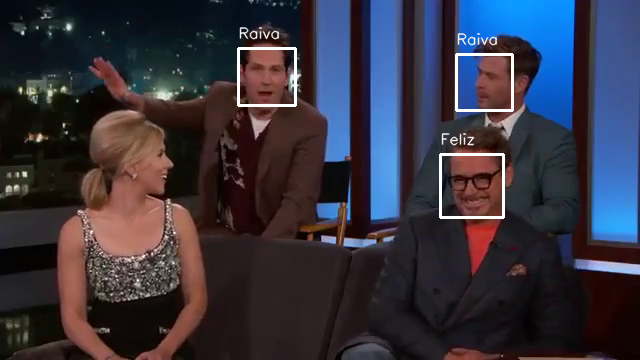

1/1 [==============================] - 0s 54ms/step


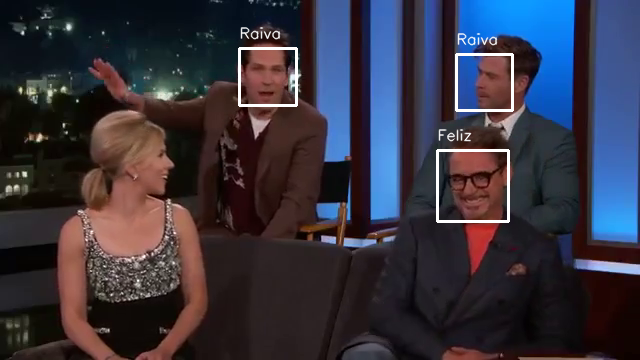

1/1 [==============================] - 0s 33ms/step


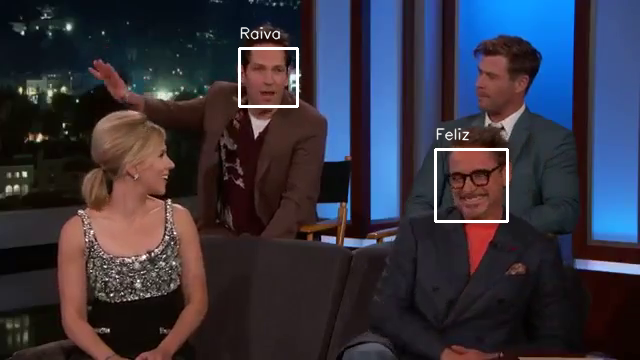

1/1 [==============================] - 0s 48ms/step


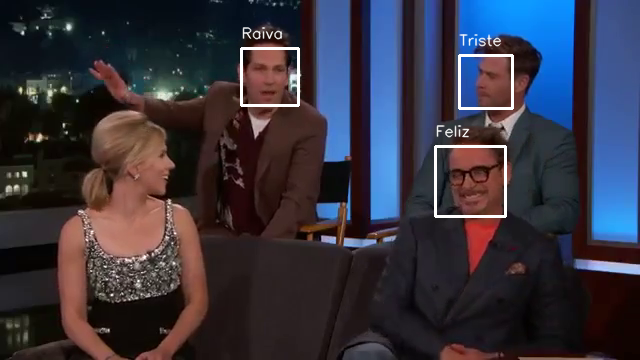

1/1 [==============================] - 0s 29ms/step


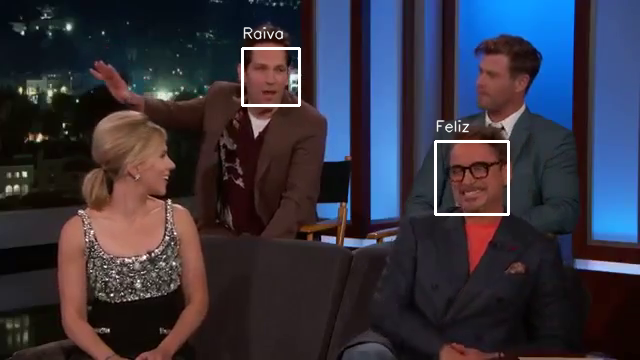

1/1 [==============================] - 0s 30ms/step


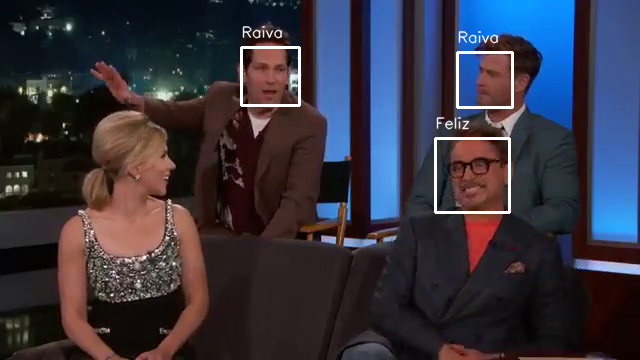

1/1 [==============================] - 0s 27ms/step


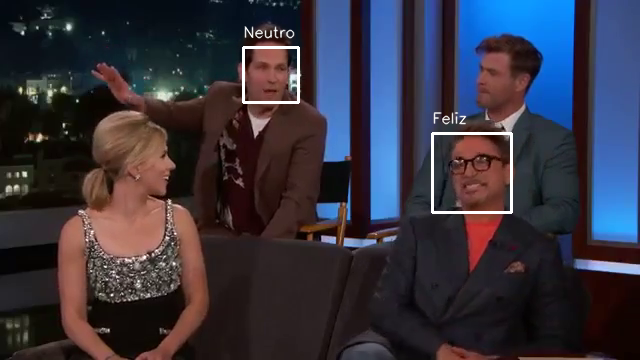

1/1 [==============================] - 0s 26ms/step


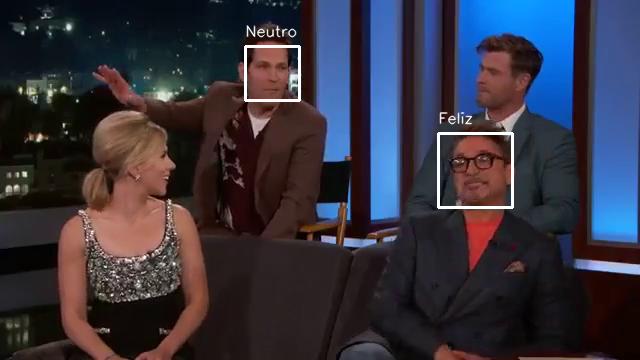

1/1 [==============================] - 0s 29ms/step


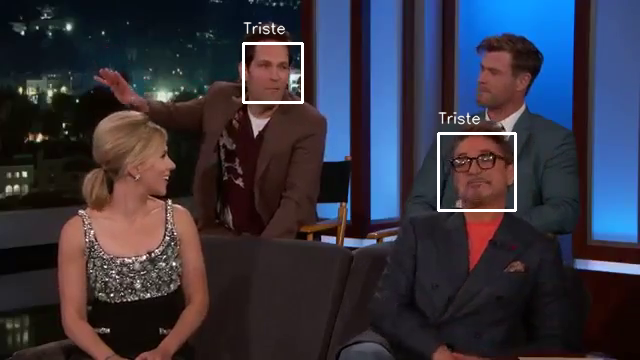

1/1 [==============================] - 0s 26ms/step


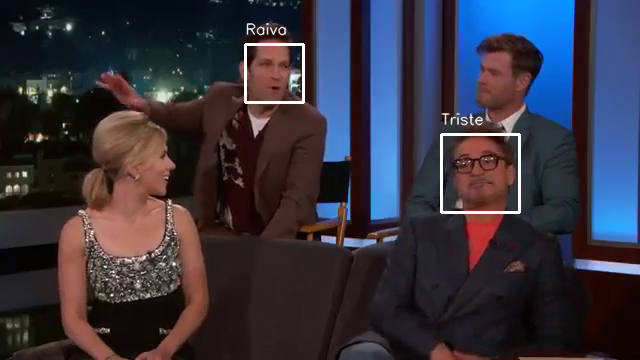

1/1 [==============================] - 0s 28ms/step


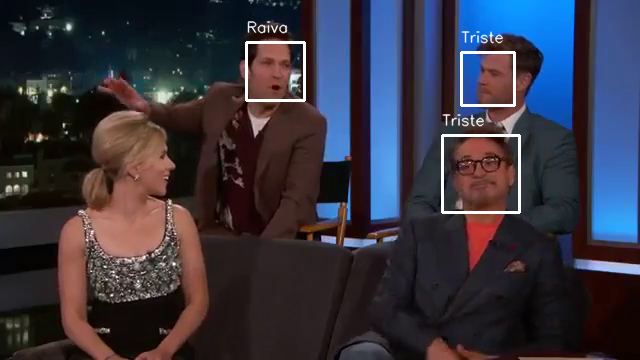

1/1 [==============================] - 0s 27ms/step


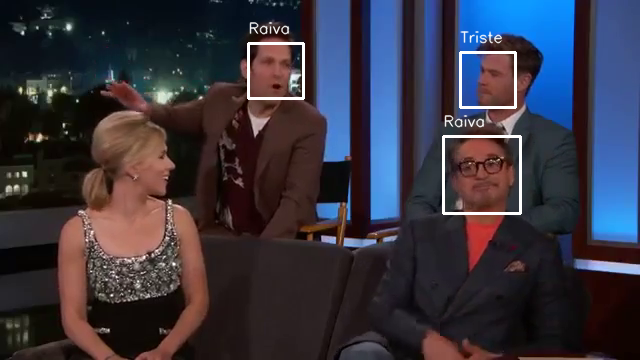

1/1 [==============================] - 0s 29ms/step


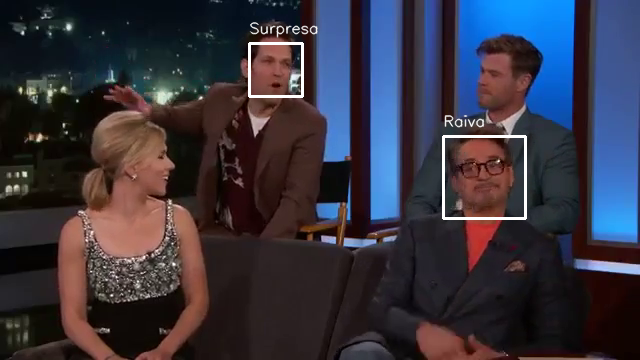

1/1 [==============================] - 0s 27ms/step


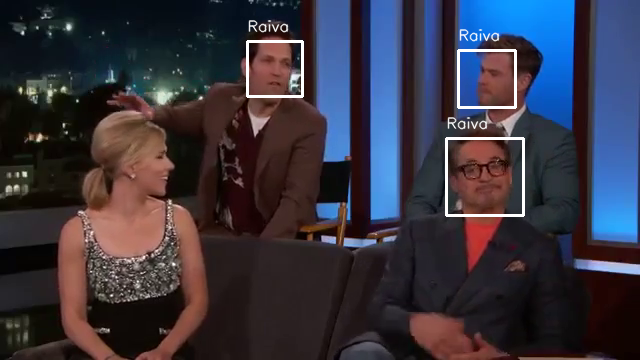

1/1 [==============================] - 0s 28ms/step


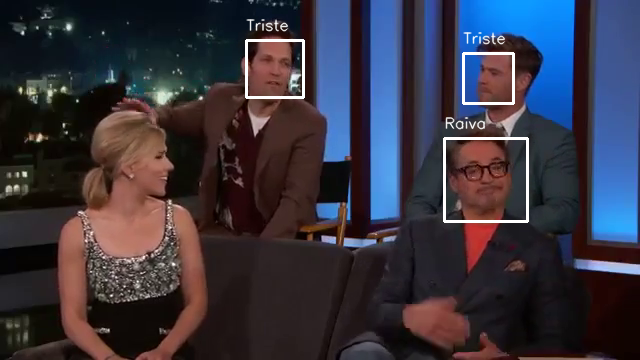

1/1 [==============================] - 0s 28ms/step


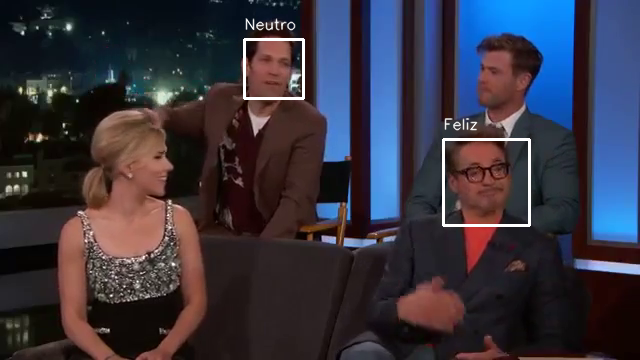

1/1 [==============================] - 0s 55ms/step


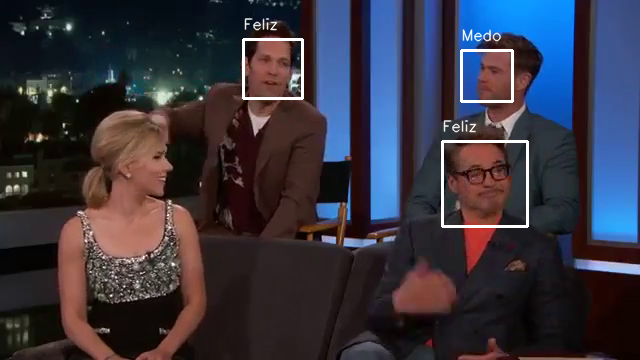

1/1 [==============================] - 0s 27ms/step


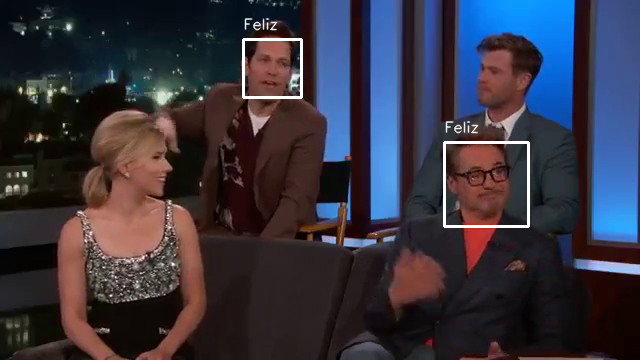

1/1 [==============================] - 0s 35ms/step


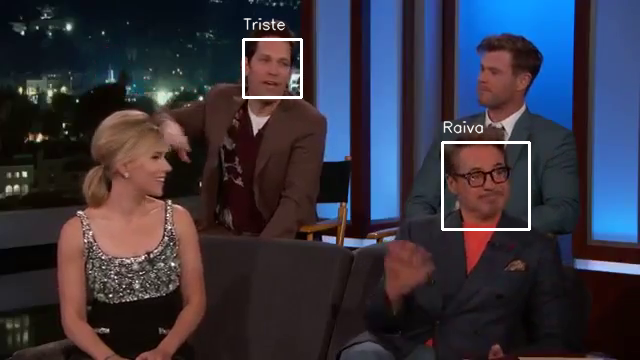

1/1 [==============================] - 0s 27ms/step


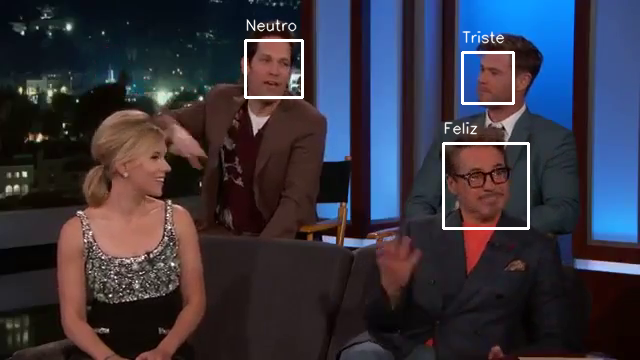

1/1 [==============================] - 0s 28ms/step


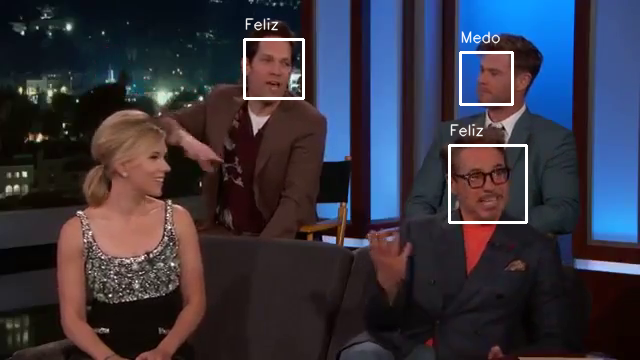

1/1 [==============================] - 0s 29ms/step


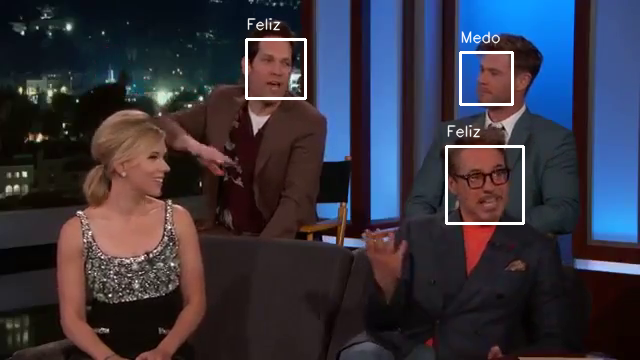

1/1 [==============================] - 0s 26ms/step


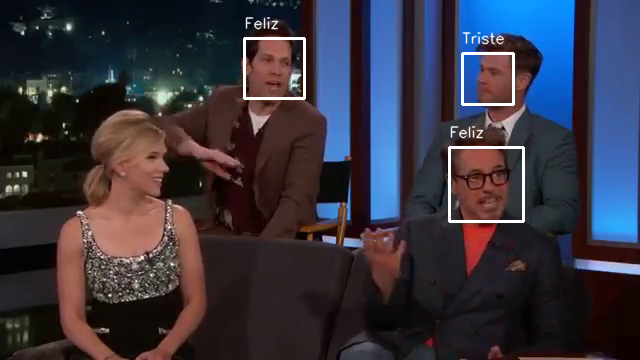

1/1 [==============================] - 0s 27ms/step


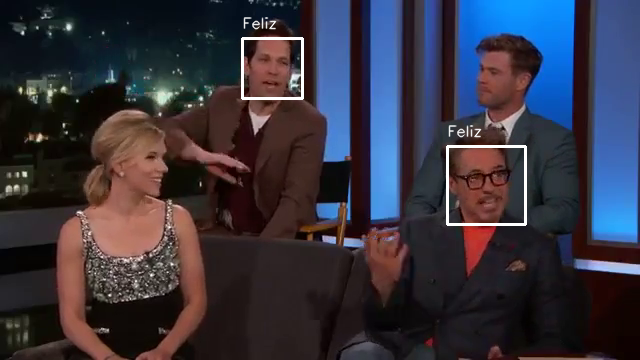

1/1 [==============================] - 0s 31ms/step


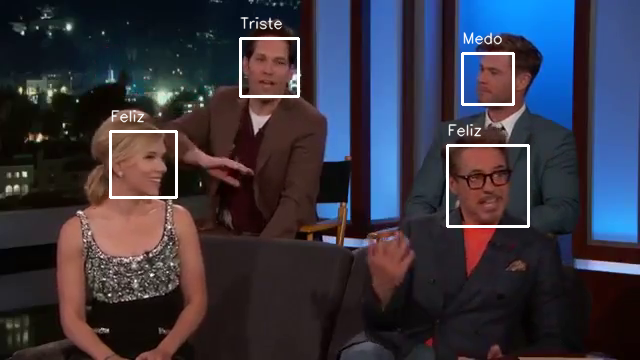

1/1 [==============================] - 0s 27ms/step


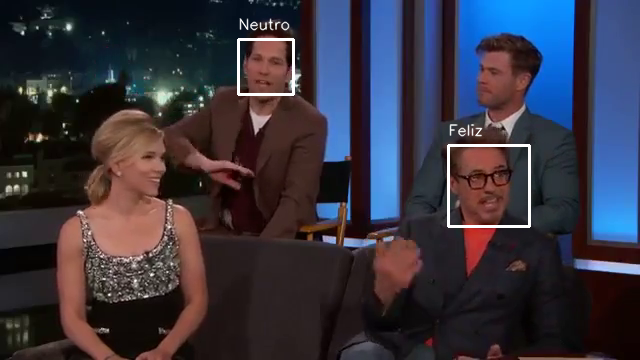

1/1 [==============================] - 0s 28ms/step


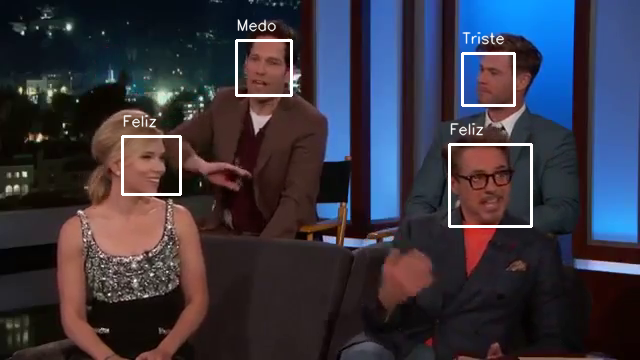

1/1 [==============================] - 0s 36ms/step


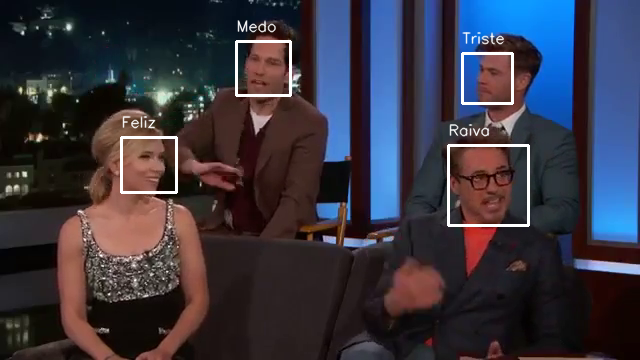

1/1 [==============================] - 0s 26ms/step


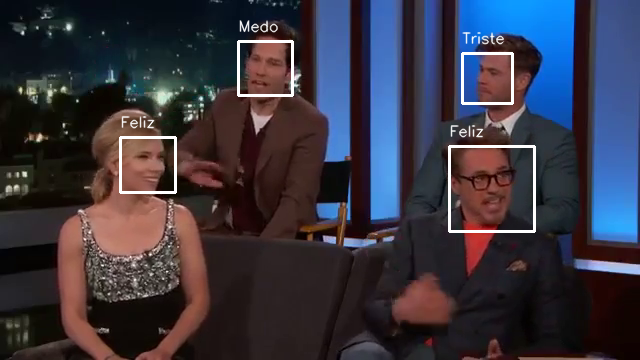

1/1 [==============================] - 0s 36ms/step


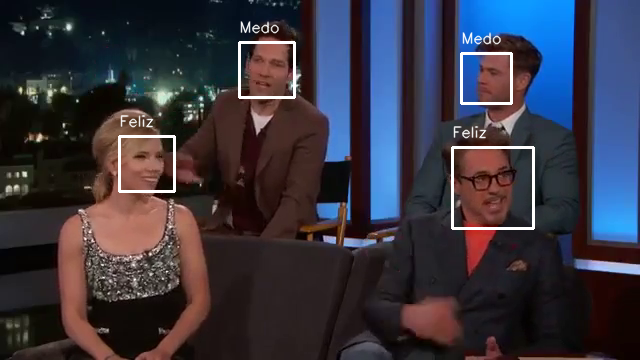

1/1 [==============================] - 0s 26ms/step


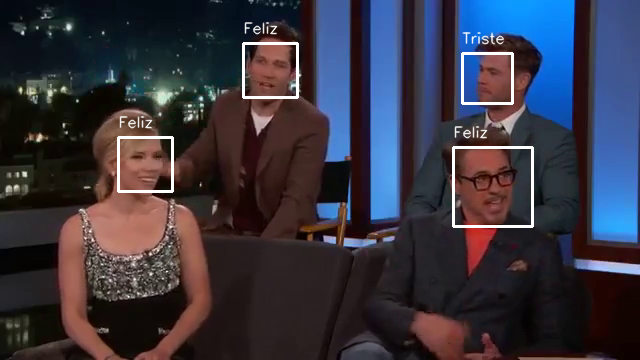

1/1 [==============================] - 0s 41ms/step


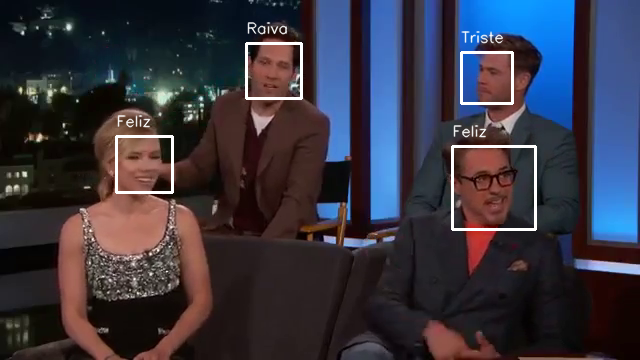

1/1 [==============================] - 0s 52ms/step


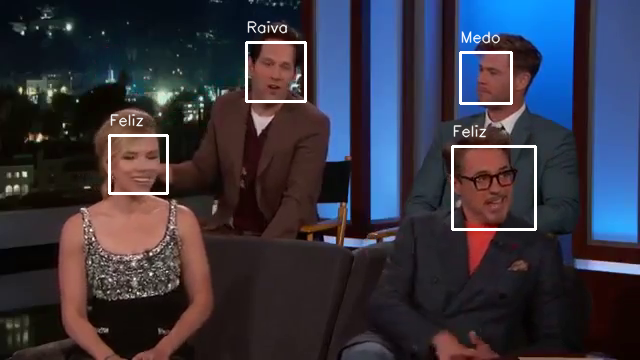

1/1 [==============================] - 0s 42ms/step


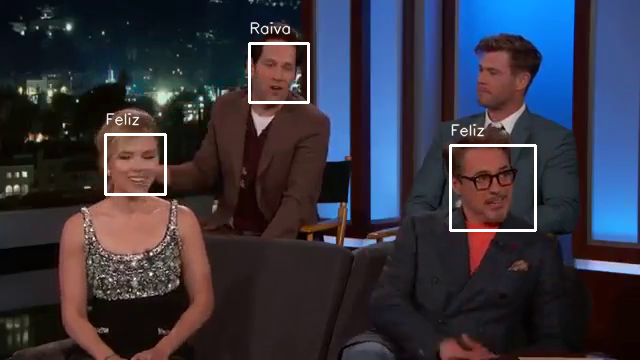

1/1 [==============================] - 0s 35ms/step


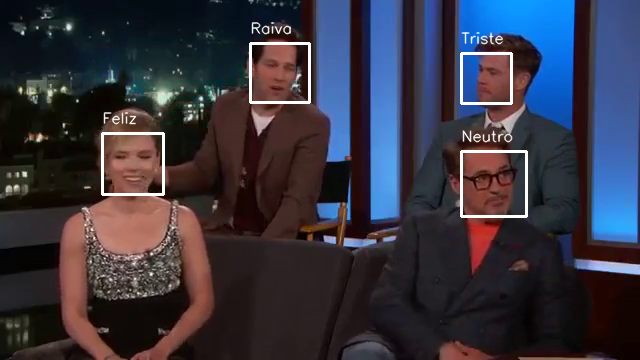

1/1 [==============================] - 0s 58ms/step


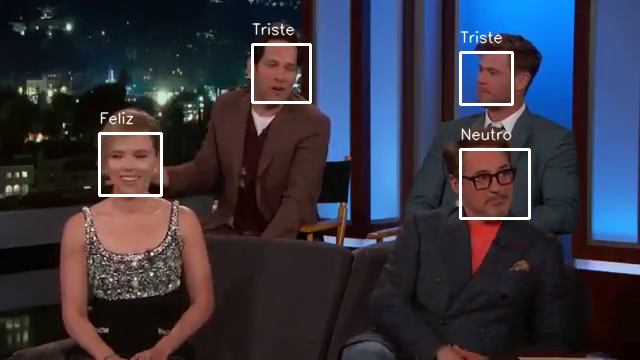

1/1 [==============================] - 0s 53ms/step


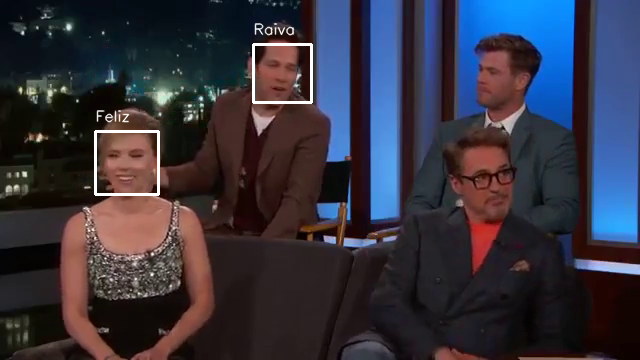

1/1 [==============================] - 0s 68ms/step


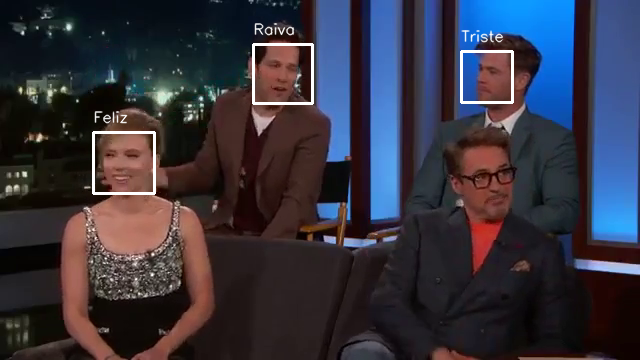

1/1 [==============================] - 0s 28ms/step


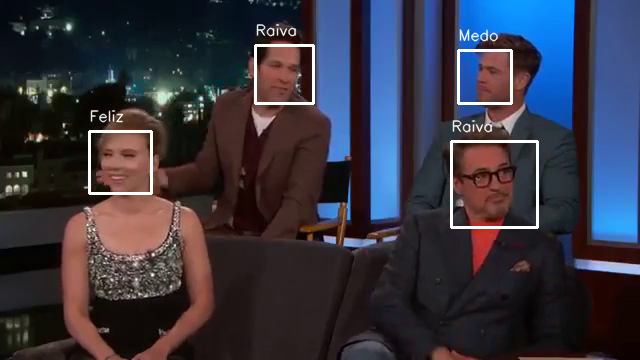

1/1 [==============================] - 0s 29ms/step


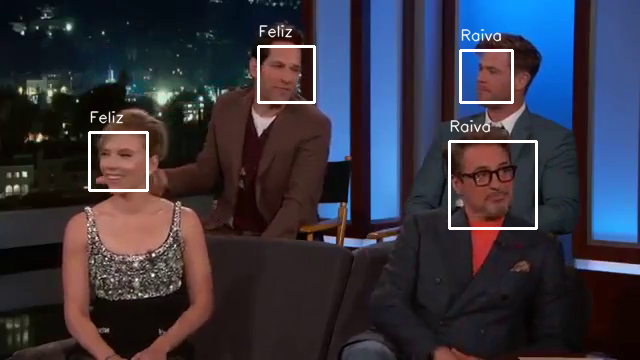

1/1 [==============================] - 0s 26ms/step


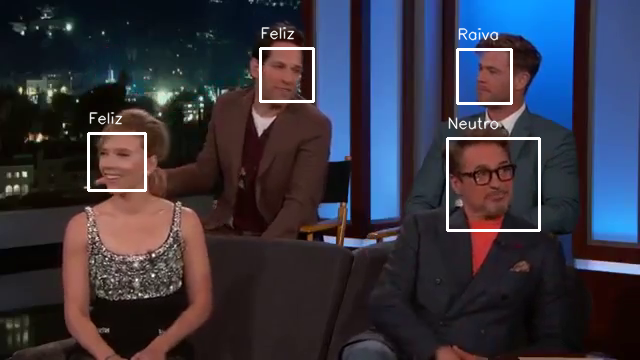

1/1 [==============================] - 0s 32ms/step


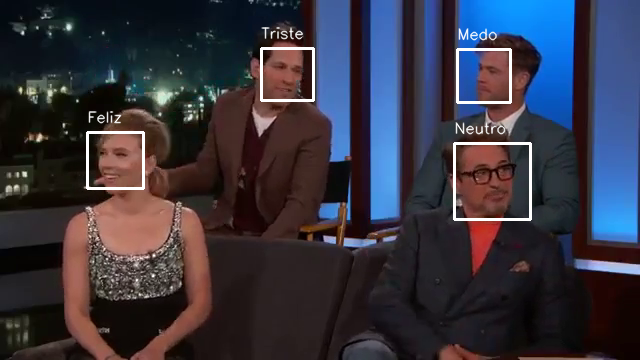

1/1 [==============================] - 0s 26ms/step


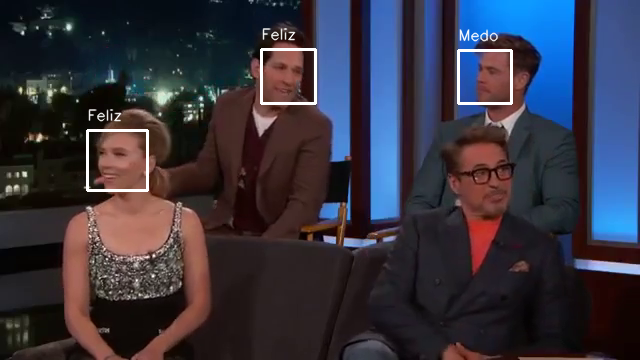

1/1 [==============================] - 0s 26ms/step


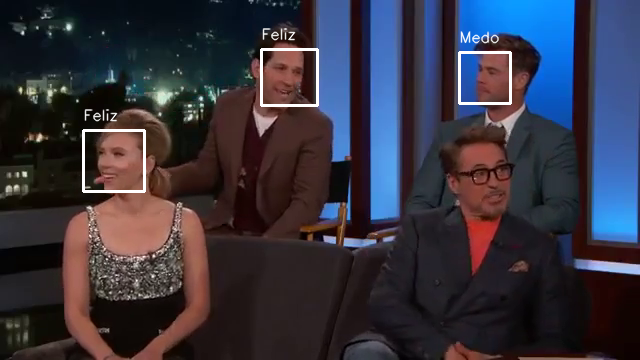

1/1 [==============================] - 0s 27ms/step


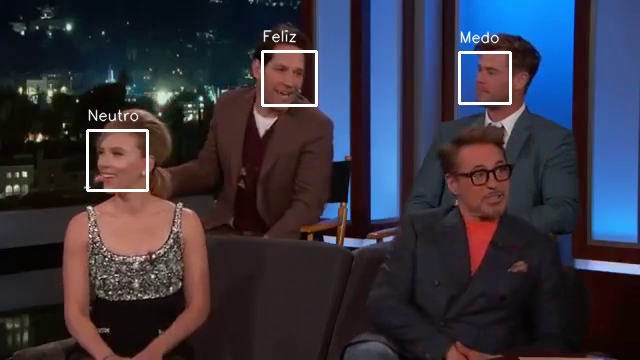

1/1 [==============================] - 0s 30ms/step


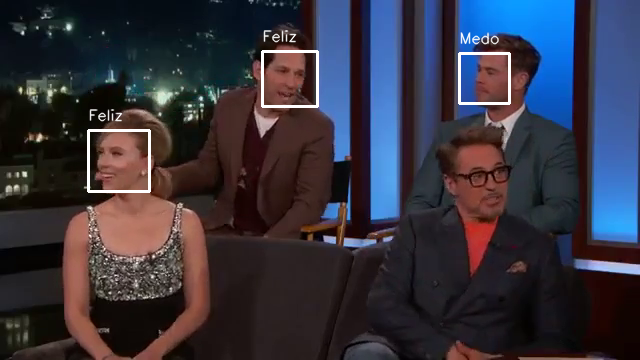

1/1 [==============================] - 0s 27ms/step


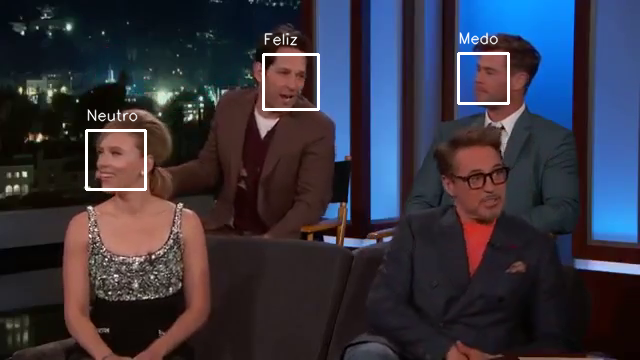

1/1 [==============================] - 0s 43ms/step


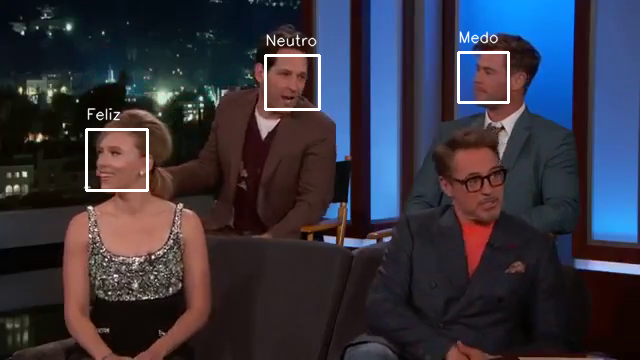

1/1 [==============================] - 0s 28ms/step


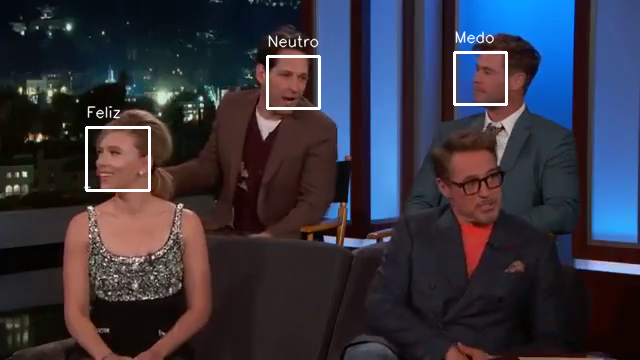

1/1 [==============================] - 0s 26ms/step


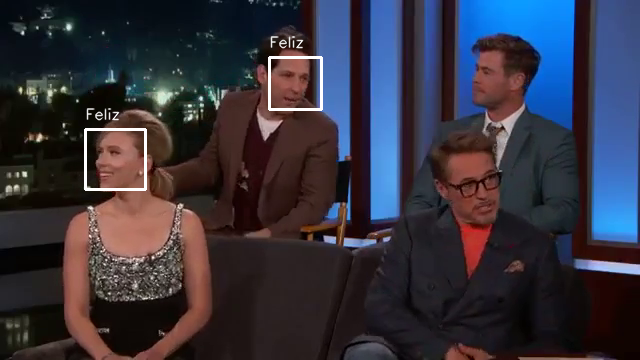

1/1 [==============================] - 0s 27ms/step


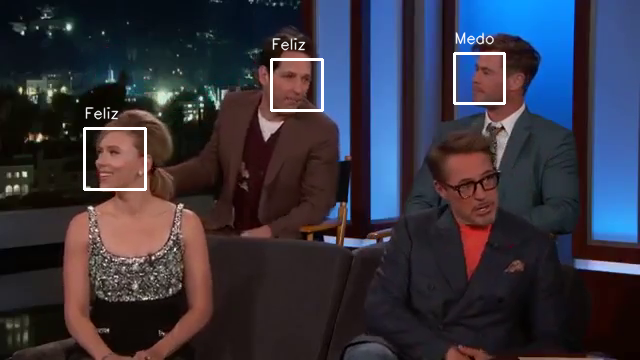

1/1 [==============================] - 0s 26ms/step


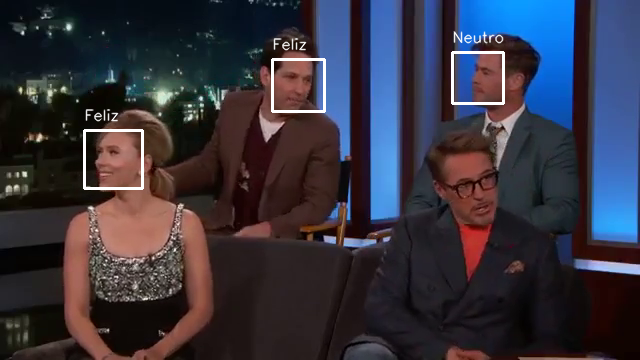

1/1 [==============================] - 0s 27ms/step


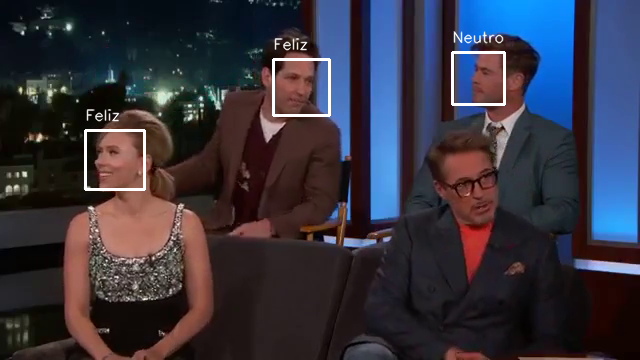

1/1 [==============================] - 0s 27ms/step


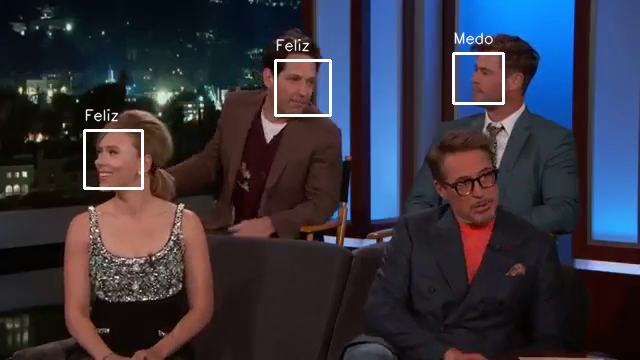

1/1 [==============================] - 0s 32ms/step


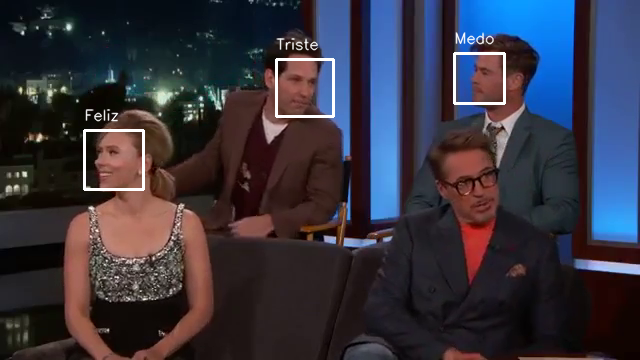

1/1 [==============================] - 0s 27ms/step


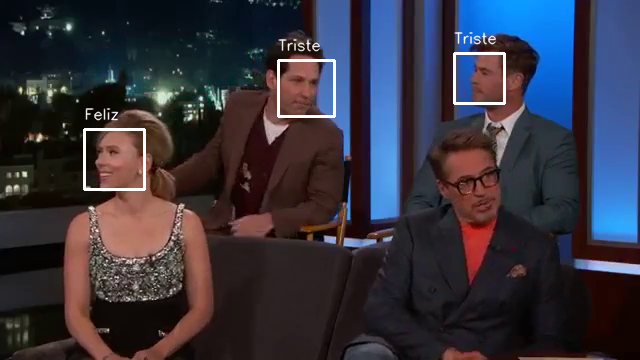

1/1 [==============================] - 0s 41ms/step


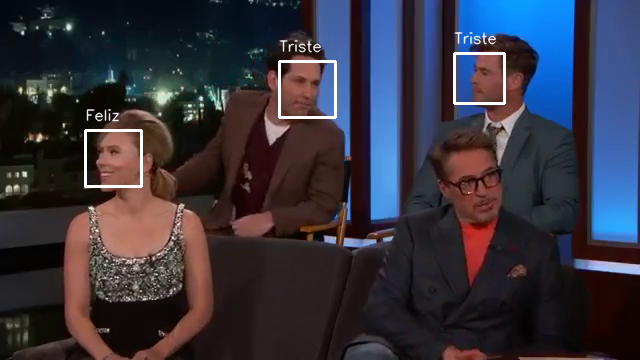

1/1 [==============================] - 0s 34ms/step


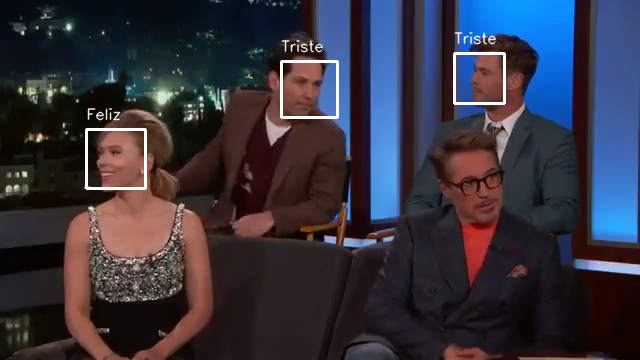

1/1 [==============================] - 0s 26ms/step


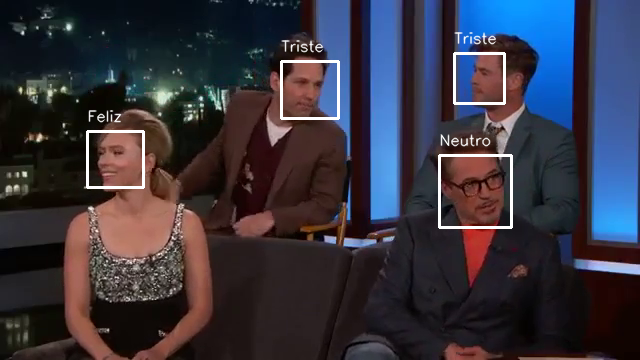

1/1 [==============================] - 0s 32ms/step


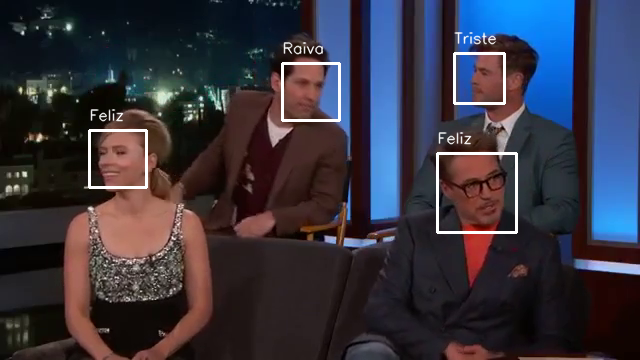

1/1 [==============================] - 0s 51ms/step


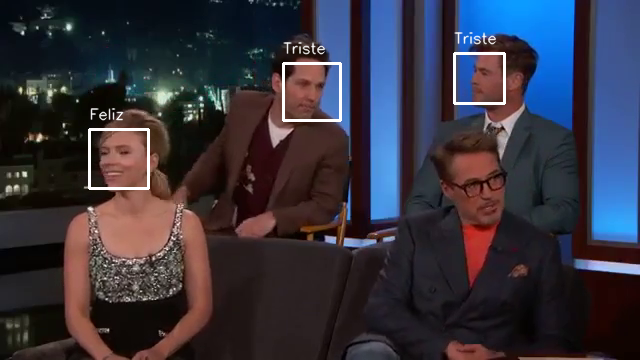

1/1 [==============================] - 0s 26ms/step


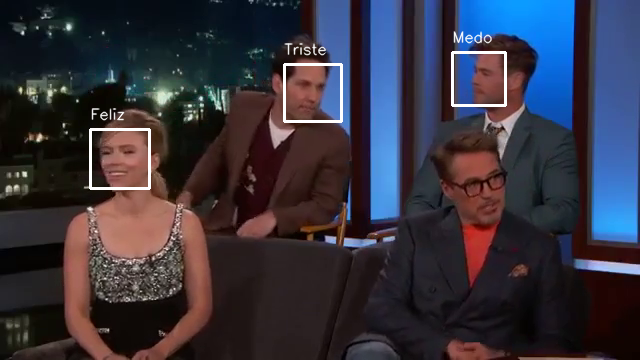

1/1 [==============================] - 0s 36ms/step


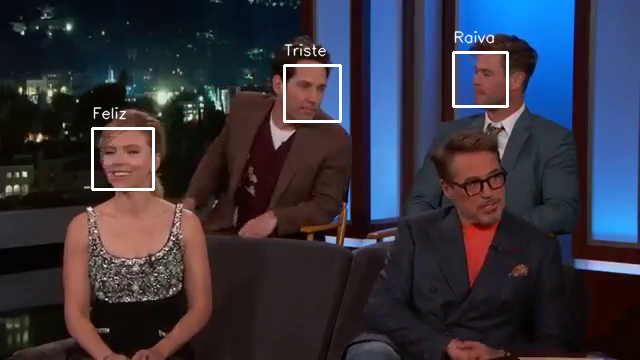

1/1 [==============================] - 0s 30ms/step


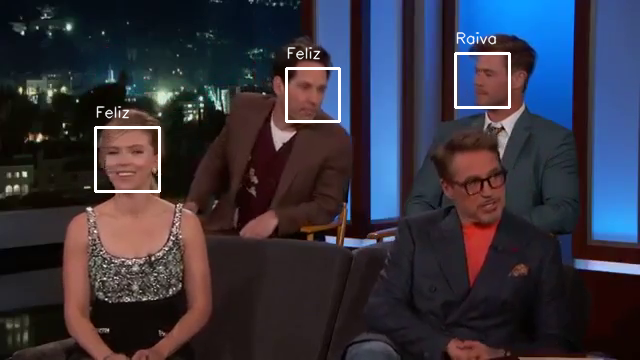

1/1 [==============================] - 0s 32ms/step


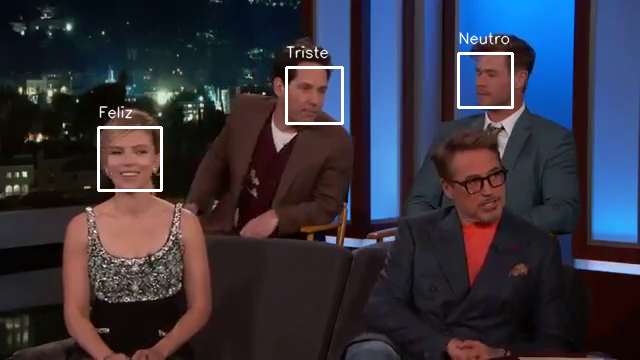

1/1 [==============================] - 0s 38ms/step


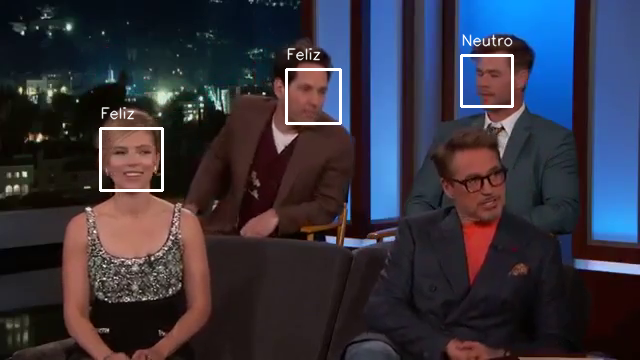

1/1 [==============================] - 0s 27ms/step


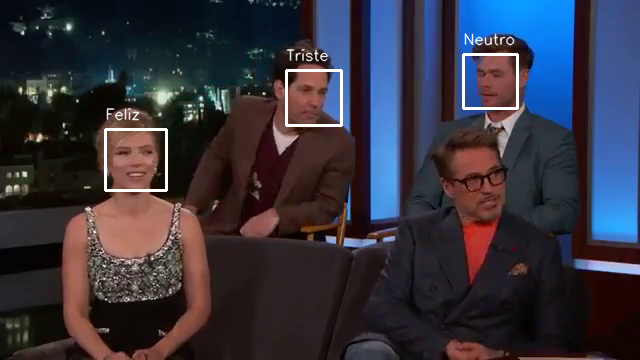

1/1 [==============================] - 0s 63ms/step


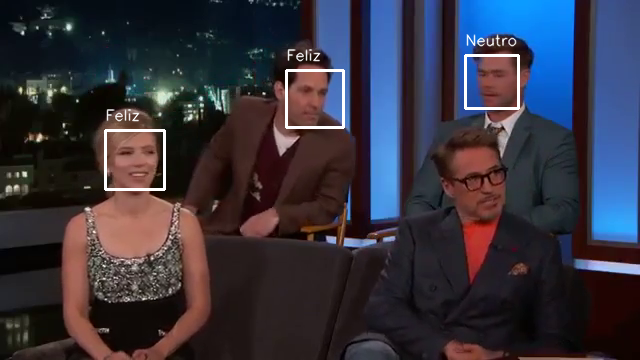

1/1 [==============================] - 0s 33ms/step


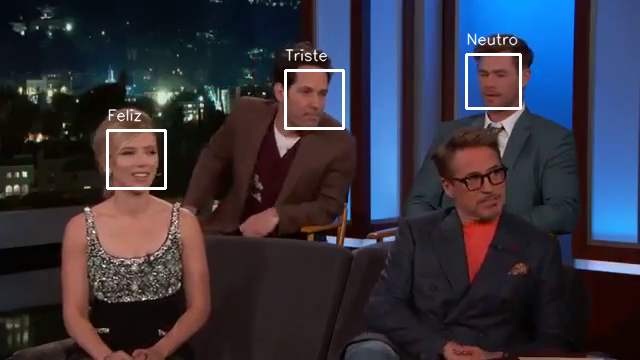

1/1 [==============================] - 0s 52ms/step


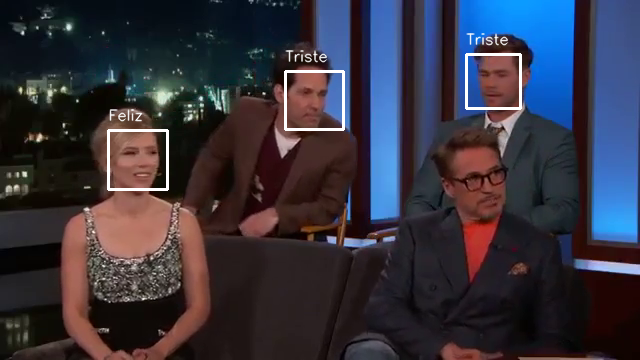

1/1 [==============================] - 0s 29ms/step


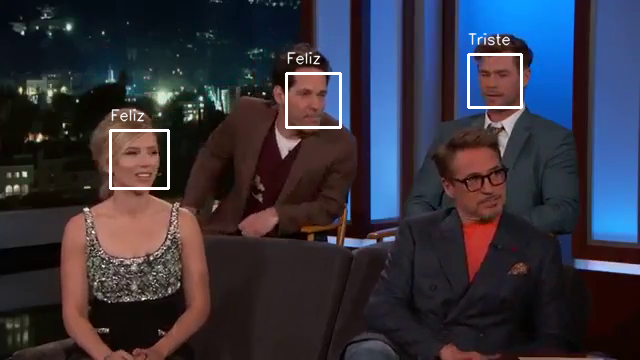

1/1 [==============================] - 0s 34ms/step


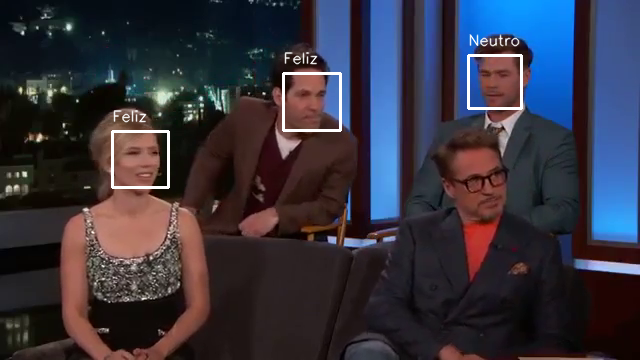

1/1 [==============================] - 0s 32ms/step


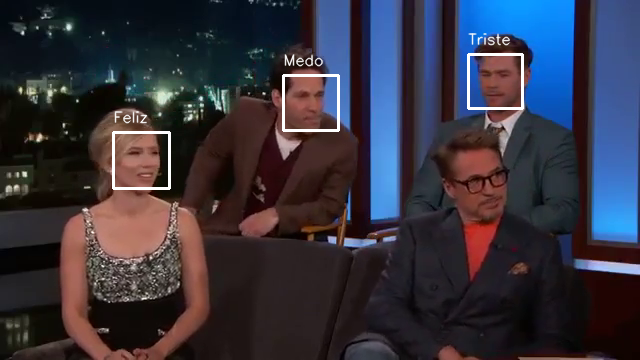

1/1 [==============================] - 0s 26ms/step


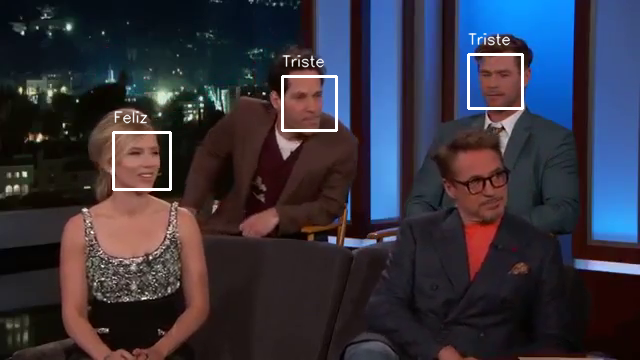

1/1 [==============================] - 0s 26ms/step


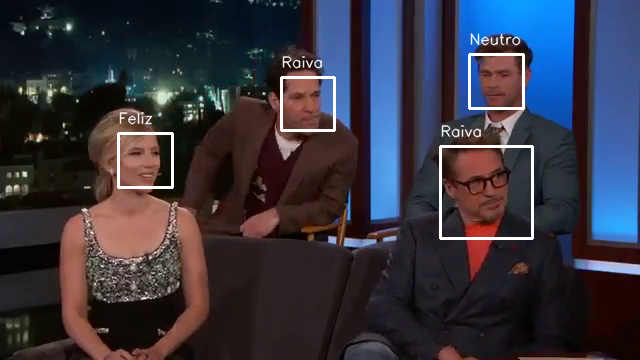

1/1 [==============================] - 0s 27ms/step


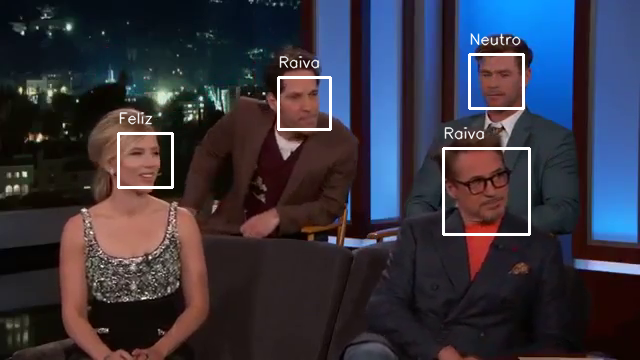

1/1 [==============================] - 0s 27ms/step


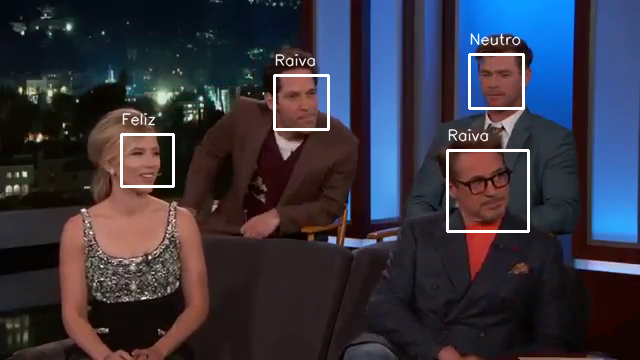

1/1 [==============================] - 0s 27ms/step


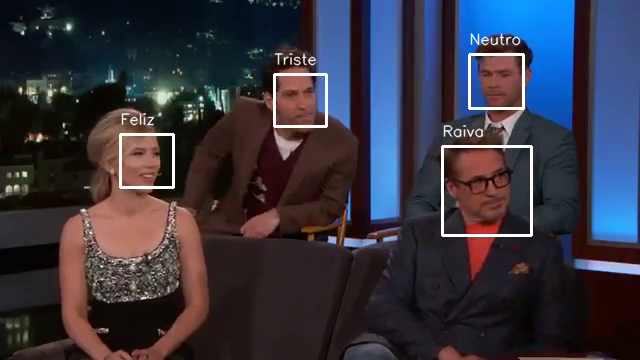

1/1 [==============================] - 0s 27ms/step


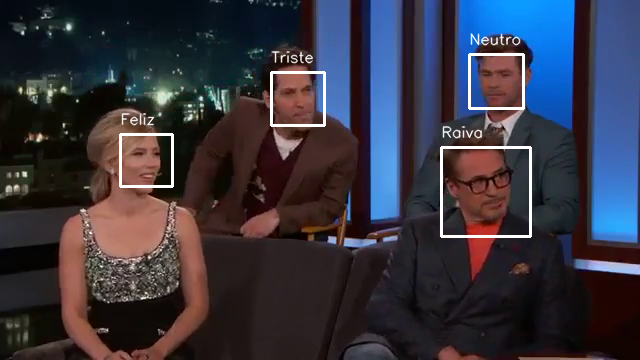

1/1 [==============================] - 0s 26ms/step


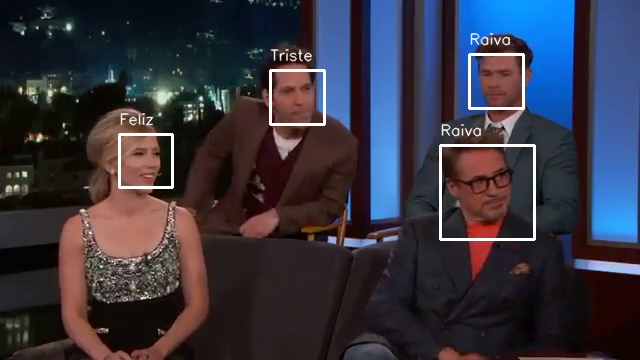

1/1 [==============================] - 0s 40ms/step


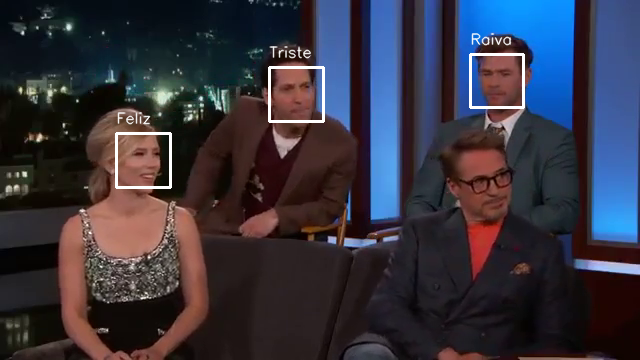

1/1 [==============================] - 0s 27ms/step


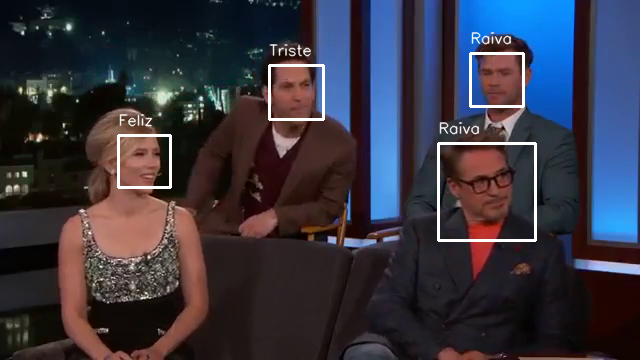

1/1 [==============================] - 0s 31ms/step


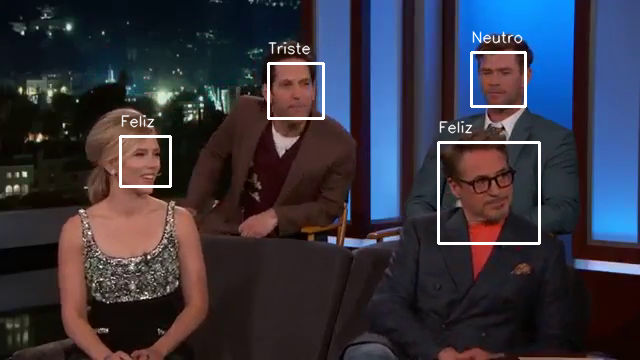

1/1 [==============================] - 0s 26ms/step


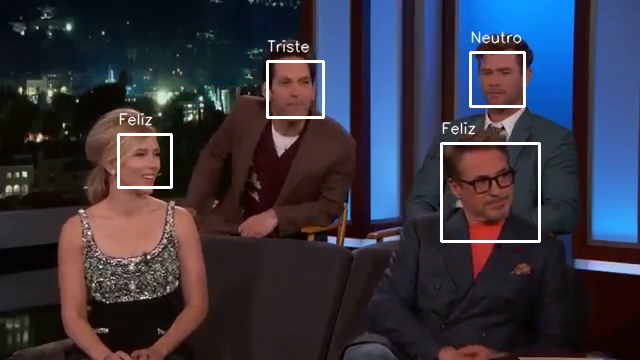

1/1 [==============================] - 0s 28ms/step


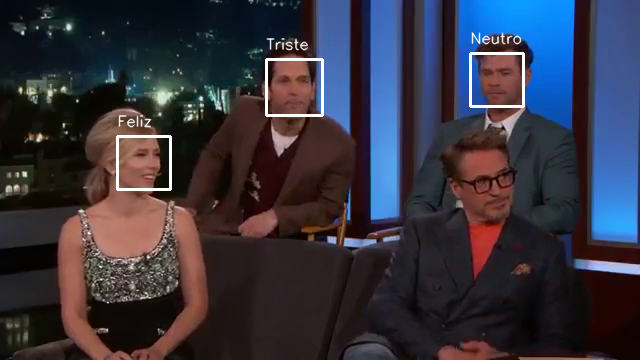

1/1 [==============================] - 0s 27ms/step


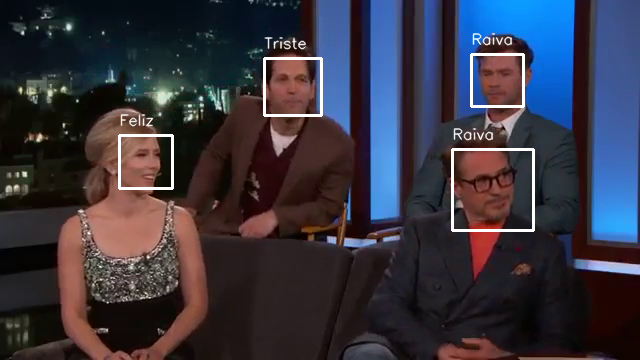

1/1 [==============================] - 0s 32ms/step


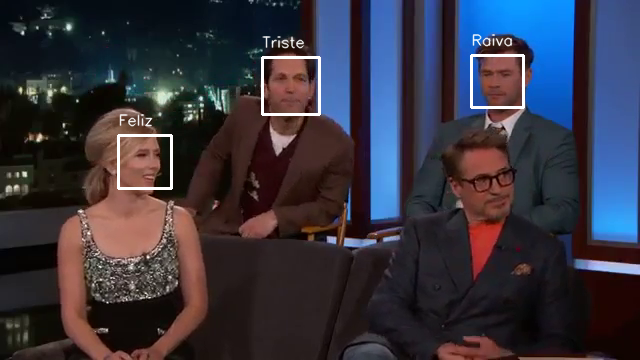

1/1 [==============================] - 0s 26ms/step


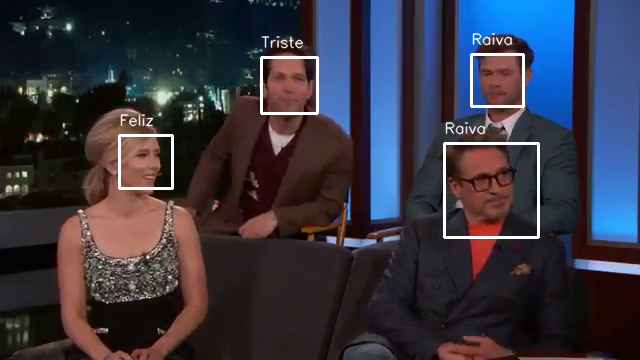

1/1 [==============================] - 0s 29ms/step


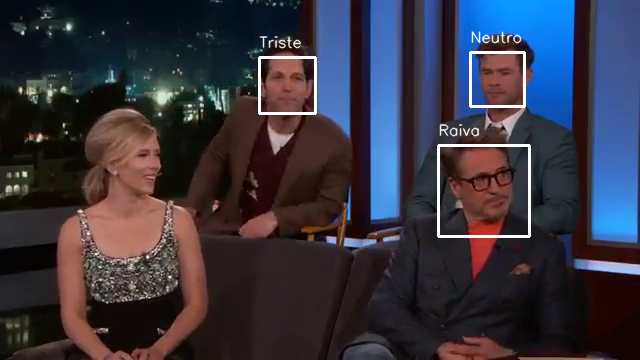

1/1 [==============================] - 0s 26ms/step


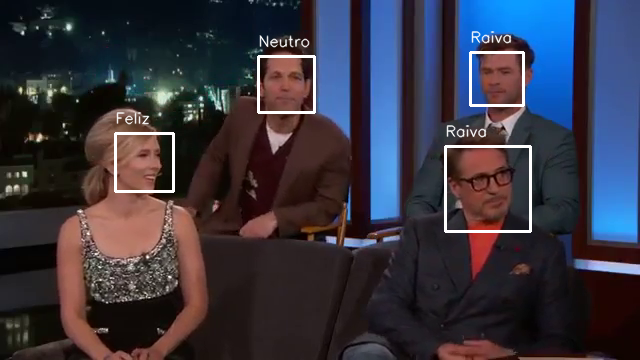

1/1 [==============================] - 0s 27ms/step


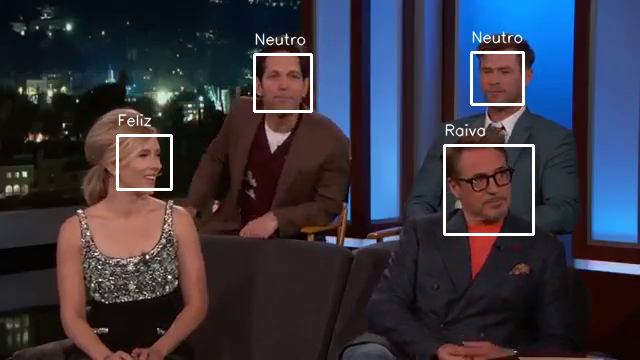

1/1 [==============================] - 0s 31ms/step


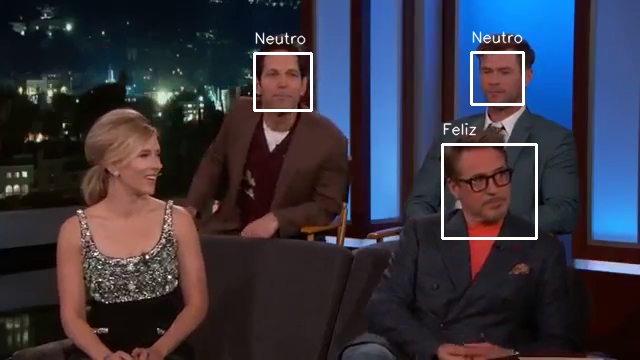

1/1 [==============================] - 0s 29ms/step


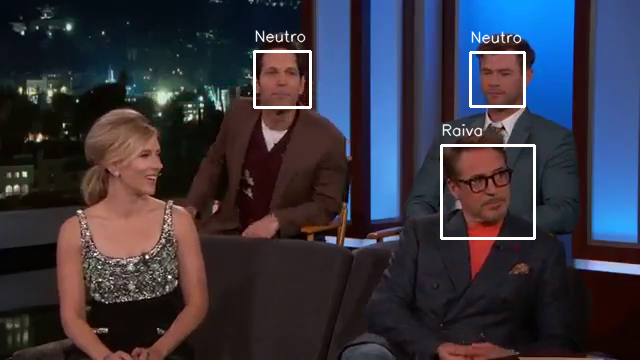

1/1 [==============================] - 0s 43ms/step


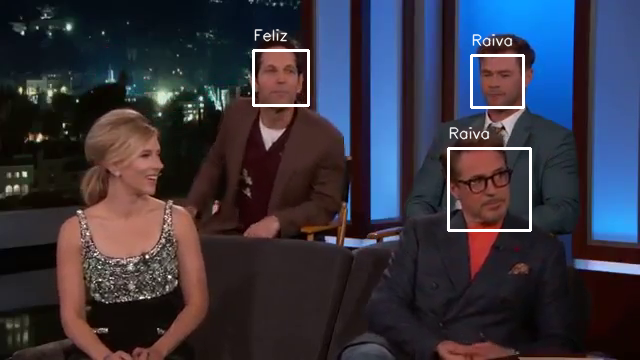

1/1 [==============================] - 0s 55ms/step


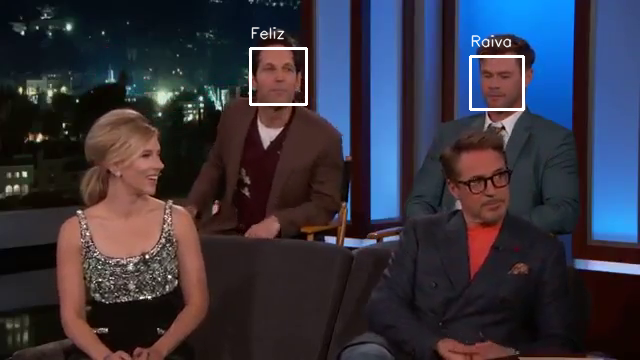

1/1 [==============================] - 0s 55ms/step


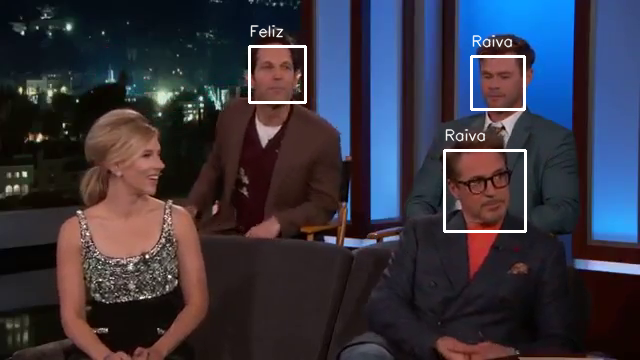

1/1 [==============================] - 0s 31ms/step


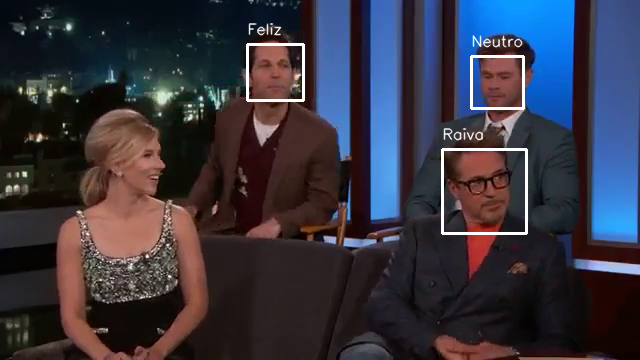

1/1 [==============================] - 0s 59ms/step


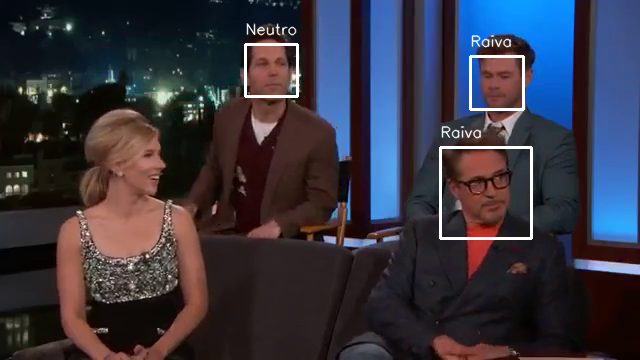

1/1 [==============================] - 0s 34ms/step


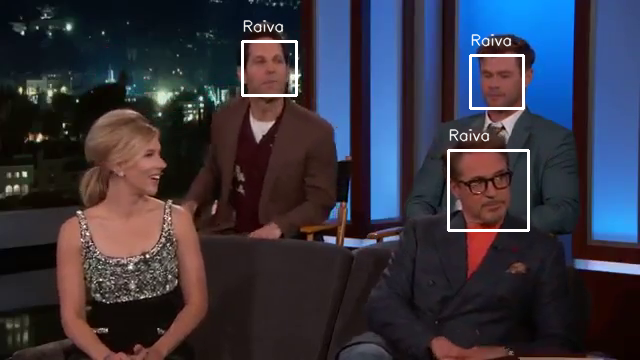

1/1 [==============================] - 0s 26ms/step


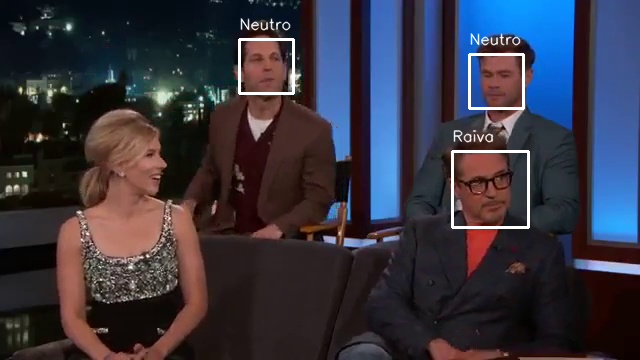

1/1 [==============================] - 0s 28ms/step


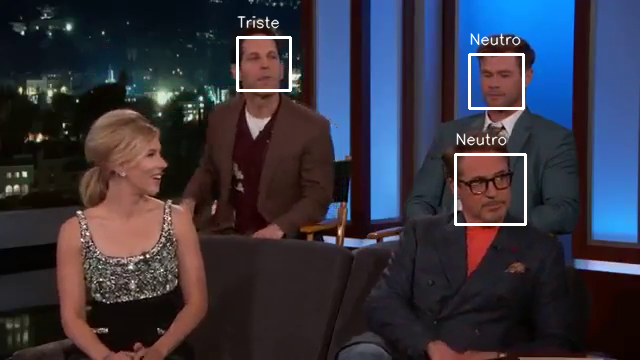

1/1 [==============================] - 0s 28ms/step


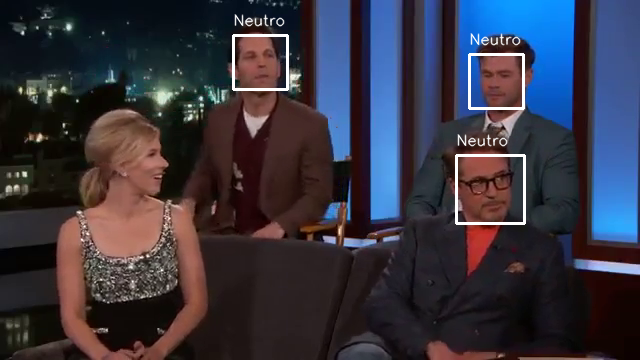

1/1 [==============================] - 0s 34ms/step


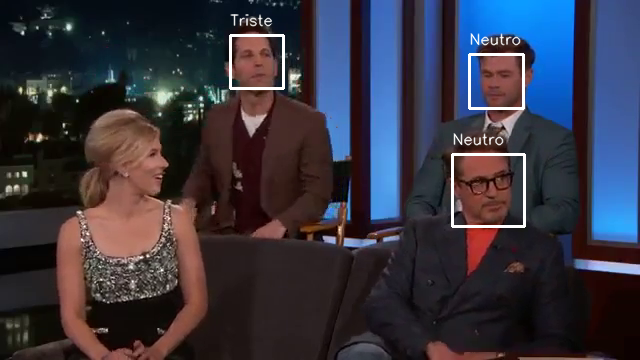

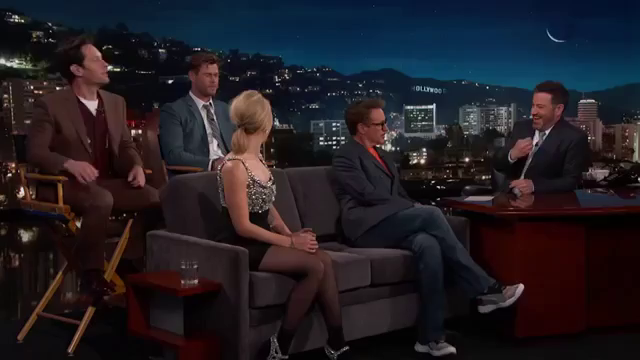

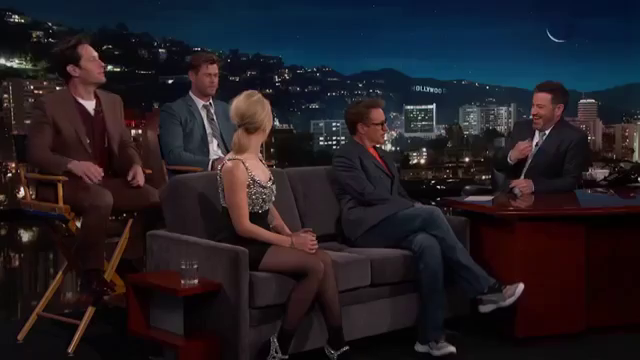

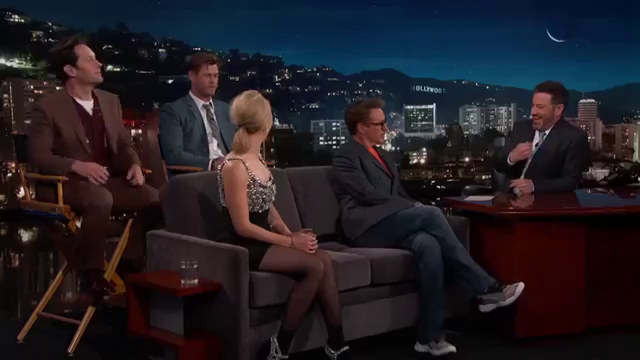

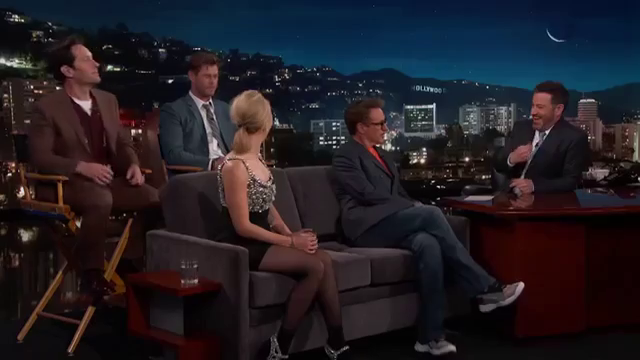

...

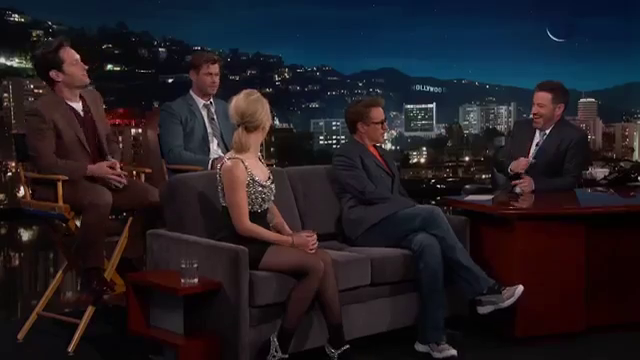

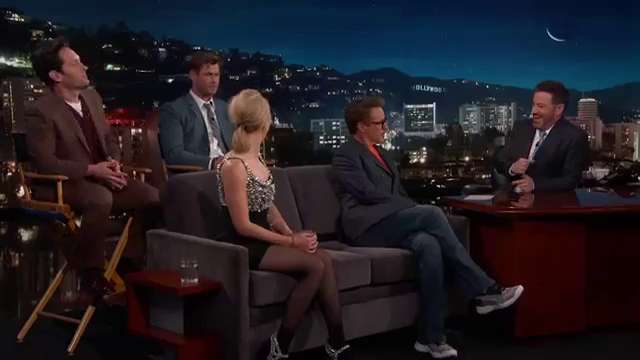

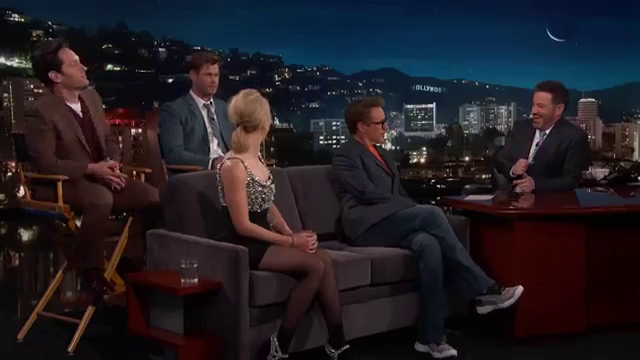

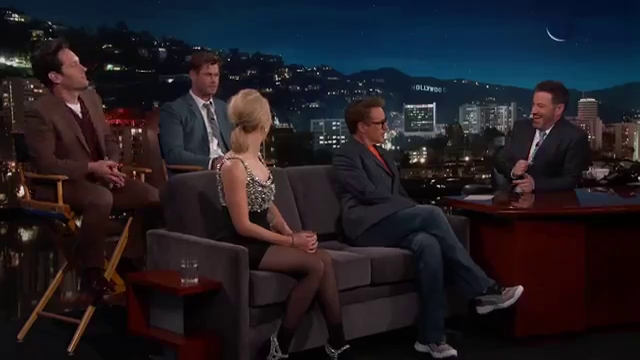

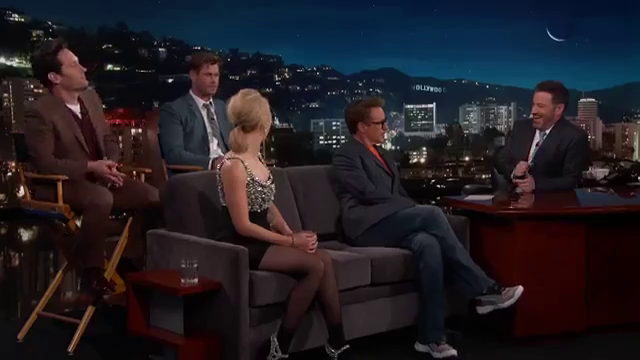

terminou


In [12]:
while(cv2.waitKey(1)<0):
  conectado, frame = cap.read()
  if not conectado:
    break
  deteccoes = detector.detectMultiScale(frame, scaleFactor=1.2, minNeighbors=5, minSize=(30,30))
  if len(deteccoes) > 0:
    for(x,y,h,w) in deteccoes:
      frame = cv2.rectangle(frame, (x,y), (x+w, y+h), (255,255,255), 2)
      roi = frame[y:y+h, x:x+w]
      roi = cv2.resize(roi, (48,48))
      roi = roi/255
      roi = np.expand_dims(roi, axis=0)
      previsao = rede.predict(roi)

      if previsao is not None:
        resultado = np.argmax(previsao)
        cv2.putText(frame, emotions[resultado], (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 1, cv2.LINE_AA)

  cv2_imshow(frame)
  output_video.write(frame)
print('terminou')
output_video.release()
cv2.destroyAllWindows()